### Pipeline
The Sequence of the Project

1. Importing Libraries
2. Data Loading and Visualization
3. Data Preprocessing
4. Model Building
5. Model Training
6. Generating a GIF

### 1. Import Libraries

Versions of Libraries -

1.   numpy - 1.19.2
2.   tensorflow - 2.4.1
3.   matplotlib - 3.3.2
4.   skimage - 0.17.2







In [4]:
!pip install imageio

In [74]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from skimage.transform import resize
import imageio
import glob
import os

### 2. Data Loading and Visualization
1. Data Loading
2. Data Visualization

Data Loading

In [6]:
import zipfile
import os

zip_path = "MRI+T1_T2+Dataset.zip"   # replace with your file name
extract_path = "/content"

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

print("Files extracted to:", extract_path)


Files extracted to: /content


In [7]:
t1_path = "/content/MRI+T1_T2+Dataset/Tr1/TrainT1"
t2_path = "/content/MRI+T1_T2+Dataset/Tr2/TrainT2"

t1_images = os.listdir(t1_path)
t2_images = os.listdir(t2_path)
# Validating filename extraction
t1_images[7]

'Image #15.png'

In [8]:
# Definition to read and extract t1 and t2 train images
# Returns a numpy array
def extract_images(ospath, imgfolder):
    img_list = []
    for file in imgfolder:
        img = imageio.imread(ospath+ '/' + file)
        img_list.append(img)
    print(img_list)
    return np.asarray(img_list) # converts list to a numpy array

In [9]:
# Data loading
t1 = extract_images(t1_path, t1_images)
t2 = extract_images(t2_path, t2_images)
print('T1 Shape: ',t1.shape)
print('T2 Shape: ',t2.shape)
print('Dataset size: ', t1.shape[0]+t2.shape[0])

[array([[1, 2, 1, ..., 1, 2, 1],
       [1, 2, 2, ..., 2, 2, 1],
       [1, 2, 2, ..., 2, 2, 1],
       ...,
       [1, 1, 0, ..., 0, 0, 0],
       [1, 1, 0, ..., 0, 0, 0],
       [1, 1, 0, ..., 0, 0, 0]], dtype=uint8), array([[1, 1, 1, ..., 1, 1, 1],
       [1, 2, 2, ..., 2, 2, 1],
       [1, 2, 2, ..., 2, 2, 1],
       ...,
       [1, 1, 0, ..., 0, 0, 0],
       [1, 1, 0, ..., 0, 0, 0],
       [1, 1, 0, ..., 0, 0, 0]], dtype=uint8), array([[0, 0, 0, ..., 1, 1, 1],
       [0, 0, 0, ..., 1, 1, 1],
       [0, 0, 0, ..., 1, 1, 1],
       ...,
       [1, 1, 0, ..., 0, 0, 0],
       [1, 1, 0, ..., 0, 0, 0],
       [1, 1, 0, ..., 0, 0, 0]], dtype=uint8), array([[1, 1, 1, ..., 1, 1, 1],
       [0, 1, 0, ..., 0, 0, 1],
       [0, 0, 0, ..., 1, 1, 1],
       ...,
       [1, 1, 0, ..., 0, 0, 0],
       [1, 1, 0, ..., 0, 0, 0],
       [1, 1, 0, ..., 0, 0, 0]], dtype=uint8), array([[1, 2, 1, ..., 1, 1, 1],
       [1, 2, 2, ..., 0, 1, 1],
       [1, 1, 1, ..., 0, 1, 1],
       ...,
       [1, 1, 0

/tmp/ipython-input-3723741761.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = imageio.imread(ospath+ '/' + file)


Data Visualization

/tmp/ipython-input-2362505733.py:1: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  t1_img = imageio.imread(t1_path+ '/' + t1_images[2])


array([[0, 0, 0, ..., 1, 1, 1],
       [0, 0, 0, ..., 1, 1, 1],
       [0, 0, 0, ..., 1, 1, 1],
       ...,
       [1, 1, 0, ..., 0, 0, 0],
       [1, 1, 0, ..., 0, 0, 0],
       [1, 1, 0, ..., 0, 0, 0]], dtype=uint8)
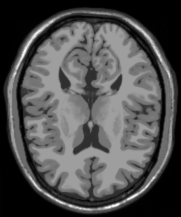

In [10]:
t1_img = imageio.imread(t1_path+ '/' + t1_images[2])
t1_img


In [11]:
image_shape = t1_img.shape
image_shape

(217, 181)

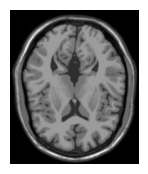

In [12]:
# Visualizing t1 image
plt.figure(figsize=(2, 2))
plt.imshow(t1[8], cmap='gray')
plt.axis('off')
plt.show()

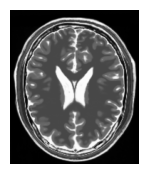

In [13]:
# VIsualizing t2 image
plt.figure(figsize=(2, 2))
plt.imshow(t2[6], cmap='gray')
plt.axis('off')
plt.show()

### 3. Data Preprocessing

In [14]:
t2

array([[[1, 1, 1, ..., 2, 1, 2],
        [1, 1, 1, ..., 1, 1, 2],
        [1, 1, 1, ..., 1, 1, 2],
        ...,
        [3, 3, 1, ..., 0, 0, 0],
        [3, 3, 1, ..., 0, 0, 0],
        [3, 3, 1, ..., 0, 0, 0]],

       [[1, 1, 1, ..., 2, 2, 2],
        [1, 1, 1, ..., 2, 1, 2],
        [1, 1, 1, ..., 1, 2, 2],
        ...,
        [3, 3, 1, ..., 1, 0, 0],
        [3, 3, 1, ..., 0, 0, 0],
        [3, 3, 1, ..., 0, 0, 0]],

       [[3, 3, 3, ..., 4, 4, 3],
        [4, 4, 4, ..., 4, 5, 4],
        [4, 4, 4, ..., 4, 4, 4],
        ...,
        [3, 3, 1, ..., 1, 1, 1],
        [3, 3, 1, ..., 1, 1, 1],
        [3, 3, 1, ..., 1, 1, 1]],

       ...,

       [[3, 3, 3, ..., 1, 1, 2],
        [2, 2, 2, ..., 2, 2, 2],
        [1, 2, 1, ..., 1, 2, 2],
        ...,
        [3, 3, 1, ..., 0, 0, 0],
        [3, 3, 1, ..., 0, 0, 0],
        [3, 3, 1, ..., 0, 1, 1]],

       [[1, 1, 1, ..., 2, 1, 2],
        [1, 1, 1, ..., 1, 1, 2],
        [1, 1, 1, ..., 1, 1, 2],
        ...,
        [3, 3, 1, ..., 

In [15]:
# Definition to normalize image
def normalize(img):
    img = (img/127.5)-1.0 # Normalize the images to [-1.0, 1.0]
    return img

In [16]:
# Normalizing t1 and t2 images
t1 = normalize(t1)
t2 = normalize(t2)

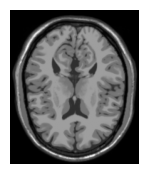

In [17]:
# Visualizing t1 image
plt.figure(figsize=(2, 2))
plt.imshow(t1[2], cmap='gray')
plt.axis('off')
plt.show()

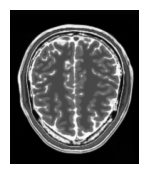

In [18]:
# Visualizing t2 image
plt.figure(figsize=(2, 2))
plt.imshow(t2[2], cmap='gray')
plt.axis('off')
plt.show()

In [46]:
# Resizing images to (64,64)
def resize_img(imgs):
    img_resized = np.zeros((imgs.shape[0], 64, 64))
    for index, img in enumerate(imgs):
        img_resized[index, :, :] = resize(img, (64, 64))
    return img_resized

In [47]:
t1_resized = resize_img(t1)
t2_resized = resize_img(t2)
print('T1 Shape: ',t1_resized.shape)
print('T2 Shape: ',t2_resized.shape)

T1 Shape:  (43, 64, 64)
T2 Shape:  (46, 64, 64)


In [48]:
# Reshape Images to (64, 64, 1) with float pixel values
t1_resized = t1_resized.reshape(t1_resized.shape[0], 64, 64, 1).astype('float32')
t2_resized = t2_resized.reshape(t2_resized.shape[0], 64, 64, 1).astype('float32')

In [49]:
# Batch and shuffle data
BATCH_SIZE = 10
t1_resized = tf.data.Dataset.from_tensor_slices(t1_resized).shuffle(t1.shape[0], seed=42).batch(BATCH_SIZE)
t2_resized = tf.data.Dataset.from_tensor_slices(t2_resized).shuffle(t2.shape[0], seed=42).batch(BATCH_SIZE)

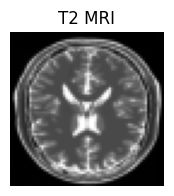

In [50]:
# Randomly visualizing resized images
t2_sample = next(iter(t2_resized))
plt.figure(figsize=(2, 2))
plt.imshow(t2_sample[7].numpy()[:, :, 0], cmap='gray')
plt.title('T2 MRI')
plt.axis('off')
plt.show()

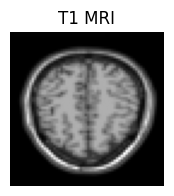

In [51]:
# Randomly visualizing resized images
t1_sample = next(iter(t1_resized))
plt.figure(figsize=(2, 2))
plt.imshow(t1_sample[5].numpy()[:, :, 0], cmap='gray')
plt.title('T1 MRI')
plt.axis('off')
plt.show()

### 4. Model Building
1. Instance Normalization
2. Downsampling, Upsampling and Unet
3. Generator Building using Unet
4. Discriminator Building

#### Instance Normalization
Instance Normalization are specially used with Style Transfer, where Separate Normalization is performed for each sample we perform channelwise Normalization.

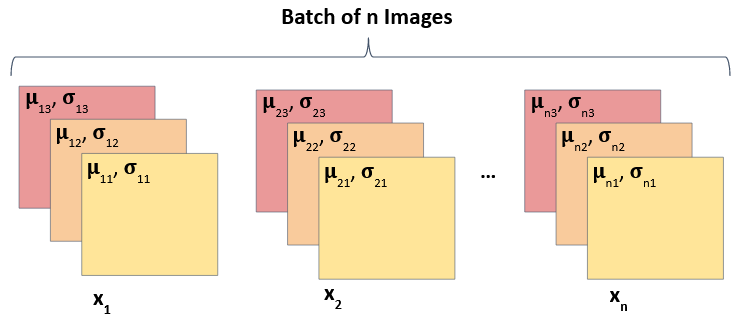

In [35]:
# Class to implement instant normalization on images
class InstanceNormalization(tf.keras.layers.Layer):
    # Initialization of Objects
    def __init__(self, epsilon=1e-5):
        # calling parent's init
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon

    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)

    def call(self, x):
        # Compute Mean and Variance, Axes=[1,2] ensures Instance Normalization
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

#### Downsampling
Downsampling is performed using the Convolution, leading to reduce in dimensions.

In [36]:
def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Conv2d layer
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    # Add Normalization layer
    if apply_norm:
        result.add(InstanceNormalization())
    # Add Leaky Relu Activation
    result.add(tf.keras.layers.LeakyReLU())
    return result

#### Upsampling
Upsampling is a result of Transposed Convolution, where dimension of image are increased.

In [37]:
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Transposed Conv2d layer
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                               kernel_initializer=initializer, use_bias=False))
    # Add Normalization Layer
    result.add(InstanceNormalization())
    # Conditionally add Dropout layer
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    # Add Relu Activation Layer
    result.add(tf.keras.layers.ReLU())
    return result

#### Unets
Unets takes Image as an input and translate it into another Image. <p>
To do this they first use Downsampling on Input Image to learn the latent characteristics of Input Image and then use Upsampling to use this knowledge to Translate it into another Image. <p>
Let's understand it through the below image.

<center>

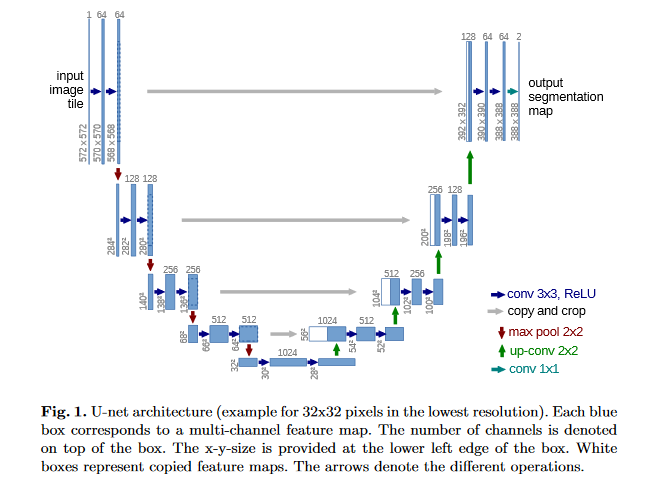

</center>

In [52]:
# Unet Generator: A combination of Convolution + Transposed Convolution Layers
def unet_generator():
    down_stack = [
        downsample(128, 4, False), # (bs, 32, 32, 128)
        downsample(256, 4), # (bs, 16, 16, 256)
        downsample(256, 4), # (bs, 8, 8, 256)
        downsample(256, 4), # (bs, 4, 4, 256)
        downsample(256, 4), # (bs, 2, 2, 256)
        downsample(256, 4) # (bs, 1, 1, 256)
    ]
    up_stack = [
        upsample(256, 4, True), # (bs, 2, 2, 256)
        upsample(256, 4, True), # (bs, 4, 4, 256)
        upsample(256, 4), #(bs, 8, 8, 256)
        upsample(256, 4),# (bs, 16, 16, 256)
        upsample(128, 4) # (bs, 32, 32, 128)
    ]
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2, padding='same', kernel_initializer=initializer, activation='tanh') # (bs, 64, 64, 1)
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[64, 64, 1])
    x = inputs
    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)

    skips = reversed(skips[:-1])
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

#### Generator
Generator is a Unet Network here since We want to translate One type of Image T1 into Another type of Image T2.

In [53]:
generator_g = unet_generator()
generator_f = unet_generator()

In [54]:
generator_g.summary()

Model: "functional_11"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 64, 64, 1) │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential          │ (None, 32, 32,    │      2,048 │ input_layer[0][0] │
│ (Sequential)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_1        │ (None, 16, 16,    │    524,800 │ sequential[0][0]  │
│ (Sequential)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_2        │ (None, 8, 8, 256) │  1,049,088 │ sequential_1[0][… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_3        │ (None, 4, 4, 256) │  1,049,088 │ sequential_2[0][… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_4        │ (None, 2, 2, 256) │  1,049,088 │ sequential_3[0][… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_5        │ (None, 1, 1, 256) │  1,049,088 │ sequential_4[0][… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_6        │ (None, 2, 2, 256) │  1,049,088 │ sequential_5[0][… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, 32, 32,    │          0 │ sequential_6[0][… │
│ (Concatenate)       │ 256)              │            │ sequential_4[0][… │
│                     │                   │            │ sequential_7[0][… │
│                     │                   │            │ sequential_3[0][… │
│                     │                   │            │ sequential_8[0][… │
│                     │                   │            │ sequential_2[0][… │
│                     │                   │            │ sequential_9[0][… │
│                     │                   │            │ sequential_1[0][… │
│                     │                   │            │ sequential_10[0]… │
│                     │                   │            │ sequential[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_7        │ (None, 4, 4, 256) │  2,097,664 │ concatenate[0][0] │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_8        │ (None, 8, 8, 256) │  2,097,664 │ concatenate[1][0] │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_9        │ (None, 16, 16,    │  2,097,664 │ concatenate[2][0] │
│ (Sequential)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_10       │ (None, 32, 32,    │  1,048,832 │ concatenate[3][0] │
│ (Sequential)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_5  │ (None, 64, 64, 1) │      4,097 │ concatenate[4][0] │
│ (Conv2DTranspose)   │                   │            │                 

 Total params: 13,118,209 (50.04 MB)

 Trainable params: 13,118,209 (50.04 MB)

 Non-trainable params: 0 (0.00 B)

#### Discriminator
Discriminator is a traditional CNN, which we use to classify the Images. It only uses Downsampling hence.

Both Discriminators have same architecture

In [55]:
# Discriminators only contain Convolutional Layers and no Transposed Convolution is used
def discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    # add input layer of size (64, 64, 1)
    inp = tf.keras.layers.Input(shape=[64, 64, 1], name='input_image')
    x = inp

    # add downsampling step here
    down1 = downsample(128, 4, False)(x) # (bs, 32, 32, 128)
    down2 = downsample(256, 4)(down1) # (bs, 16, 16, 128)
    # add a padding layer here
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down2) # (bs, 18, 18, 256)

    # implement a concrete downsampling layer here
    conv = tf.keras.layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1) # (bs, 15, 15, 512)
    norm1 = InstanceNormalization()(conv)
    leaky_relu = tf.keras.layers.LeakyReLU()(norm1)

    # apply zero padding layer
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 17, 17, 512)

    # add a last pure 2D Convolution layer
    last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2) # (bs, 14, 14, 1)
    return tf.keras.Model(inputs=inp, outputs=last)

In [56]:
discriminator_x = discriminator()
discriminator_y = discriminator()

In [57]:
discriminator_x.summary()

Model: "functional_26"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_image (InputLayer)        │ (None, 64, 64, 1)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ sequential_22 (Sequential)      │ (None, 32, 32, 128)    │         2,048 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ sequential_23 (Sequential)      │ (None, 16, 16, 256)    │       524,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ zero_padding2d (ZeroPadding2D)  │ (None, 18, 18, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_14 (Conv2D)              │ (None, 15, 15, 512)    │     2,097,152 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ instance_normalization_21       │ (None, 15, 15, 512)    │         1,024 │
│ (InstanceNormalization)         │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_14 (LeakyReLU)      │ (None, 15, 15, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ zero_padding2d_1                │ (None, 17, 17, 512)    │             0 │
│ (ZeroPadding2D)                 │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_15 (Conv2D)              │ (None, 14, 14, 1)      │         8,193 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,633,217 (10.04 MB)

 Trainable params: 2,633,217 (10.04 MB)

 Non-trainable params: 0 (0.00 B)

In [58]:
discriminator_y.summary()

Model: "functional_29"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_image (InputLayer)        │ (None, 64, 64, 1)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ sequential_24 (Sequential)      │ (None, 32, 32, 128)    │         2,048 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ sequential_25 (Sequential)      │ (None, 16, 16, 256)    │       524,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ zero_padding2d_2                │ (None, 18, 18, 256)    │             0 │
│ (ZeroPadding2D)                 │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_18 (Conv2D)              │ (None, 15, 15, 512)    │     2,097,152 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ instance_normalization_23       │ (None, 15, 15, 512)    │         1,024 │
│ (InstanceNormalization)         │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_17 (LeakyReLU)      │ (None, 15, 15, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ zero_padding2d_3                │ (None, 17, 17, 512)    │             0 │
│ (ZeroPadding2D)                 │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_19 (Conv2D)              │ (None, 14, 14, 1)      │         8,193 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,633,217 (10.04 MB)

 Trainable params: 2,633,217 (10.04 MB)

 Non-trainable params: 0 (0.00 B)

### 5. Model Training
1. Declare Loss type
2. Calculate Discriminator Loss
3. Calculate Generator Loss
4. Cycle Loss
5. Identity Loss
6. Optimizer
7. Checkpoint Initialization
8. Training Flow

Check output of Untrained Generator models which should be a random noise

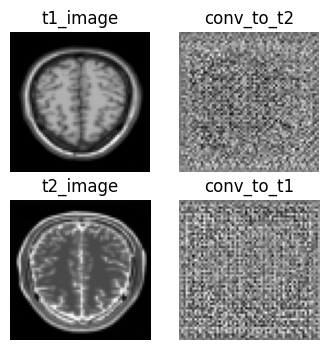

In [59]:
# Verify output of untrained Generator models which should be a random noise
conv_to_t2 = generator_g(t1_sample)
conv_to_t1 = generator_f(t2_sample)
plt.figure(figsize=(4, 4))

imgs = [t1_sample, conv_to_t2, t2_sample, conv_to_t1]
title = ['t1_image', 'conv_to_t2', 't2_image', 'conv_to_t1']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    plt.imshow(imgs[i][0].numpy()[:, :, 0], cmap='gray')
    plt.axis('off')
plt.show()

#### Declare Loss as Binary Cross Entropy
Since Our Discriminator is a classifier

In [60]:
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

#### Discriminator Loss
It consists of two types of losses
1.    Loss on Real Data
2.    Loss on Fake Data

In [61]:
def discriminator_loss(real, generated):
    real_loss = loss_obj(tf.ones_like(real), real)
    generated_loss = loss_obj(tf.zeros_like(generated), generated)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss * 0.5 # mean of losses

#### Generator Loss
It has only one type of loss - Discriminator Loss on Generated data

In [62]:
def generator_loss(generated):
    return loss_obj(tf.ones_like(generated), generated)

#### Cycle Loss
When we use both of Generators sequentially on a Input Image, we get Cycle Image and the L1 Loss between these two is called Cycle Loss.

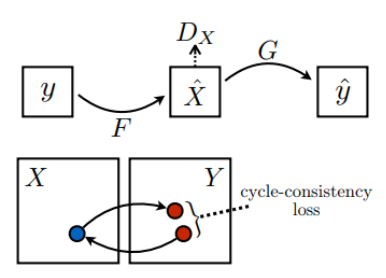

In [63]:
def calc_cycle_loss(real_image, cycled_image):
    loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return 10.0 * loss1

#### Identity Loss
When we provide input image to the Generator such that no translation is needed because the Image is already transformed. Here also we take L1 Loss between Input and Output Image.

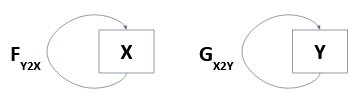

In [64]:
def identity_loss(real_image, same_image):
    loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return 0.5*loss

#### Optimizer
We use Adam Optimizer to update weights which is a good optimizer to achieve quick learning.

In [65]:
# Leveraging Adam Optimizer to smoothen gradient descent
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

We'll train out Model for 20 Epochs

In [78]:
EPOCHS = 100

#### Checkpoint Initialization
Initialize checkpoints to save models

In [66]:
checkpoint_path = "./Trained_Model"

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=3)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Latest checkpoint restored!!')

Function to show Images output by Generators while Training

In [67]:
# Definition to show generated output whilst training
def generate_images(model1, test_input1, model2, test_input2):
    prediction1 = model1(test_input1)
    prediction2 = model2(test_input2)
    plt.figure(figsize=(8, 4))
    display_list = [test_input1[0], prediction1[0], test_input2[0], prediction2[0]]
    title = ['Input Image', 'Generated Image', 'Input Image', 'Generated Image']
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i].numpy()[:, :, 0], cmap='gray')
        plt.axis('off')

    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

#### Training FLow
Below Function performs one Flow of Batch Training <p>
Notice that Identity Loss and Cycle Loss are only used in training Generator and not Discriminator

Sequence of Training Flow


1.   Generate Fake Y and Cycled X
2.   Generate Fake X and Cycled Y
3.   Generate Fake Images through G and F for Identity Loss.
4.   Calculate Discriminator Loss for Disc X and Disc Y on Fake Data for Generator Training.
5.   Calculate Generator Loss on Discriminator.
6.   Calculate Cycled Loss on Cycled Images from step 1 and 2.
7.   Calculate Total Generator Loss - Disc Loss + Cycled Loss + Identity Loss
8.   Calculate Discriminator Loss on both Fake and Real Images for Disc X and Y for Disc Training.
9.   Calculate the Gradients and update the weight and bias of models.



In [68]:
@tf.function
def train_step(real_x, real_y):
    # persistent is set to True because the tape is used more than
    # once to calculate the gradients.
    with tf.GradientTape(persistent=True) as tape:
        # Generator G translates X -> Y
        # Generator F translates Y -> X
        fake_y = generator_g(real_x, training=True)
        cycled_x = generator_f(fake_y, training=True)

        fake_x = generator_f(real_y, training=True)
        cycled_y = generator_g(fake_x, training=True)

        # same_x and same_y are used for identity loss.
        same_x = generator_f(real_x, training=True)
        same_y = generator_g(real_y, training=True)

        disc_real_x = discriminator_x(real_x, training=True)
        disc_real_y = discriminator_y(real_y, training=True)

        disc_fake_x = discriminator_x(fake_x, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)

        # calculate the loss
        gen_g_loss = generator_loss(disc_fake_y)
        gen_f_loss = generator_loss(disc_fake_x)

        total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)

        # Total generator loss = BCE loss + cycle loss + identity loss
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

        # Discriminator's loss
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)

    # Calculate the gradients for generator and discriminator
    generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
    generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)

    discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
    discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)

    # Apply the gradients to the optimizer
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))

    discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
    discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))

In [69]:
# Verify if GPU is set as the default device for training
tf.compat.v1.Session(config=tf.compat.v1.ConfigProto(log_device_placement=True))

Device mapping:
/job:localhost/replica:0/task:0/device:GPU:0 -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5



#### Train the CycleGAN Model for several Epochs
Loop training function for number of epochs and also show the output at each step. <p>
Note how Generators are getting better at producing realistic images epoch by epoch

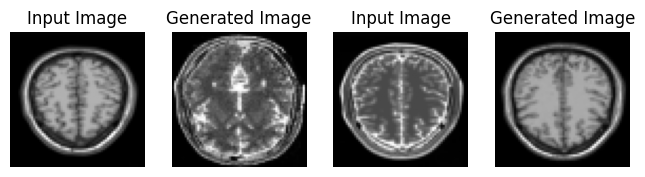

Saving checkpoint for epoch 1 at ./Trained_Model/ckpt-271


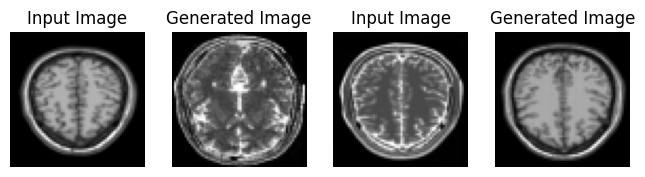

Saving checkpoint for epoch 2 at ./Trained_Model/ckpt-272


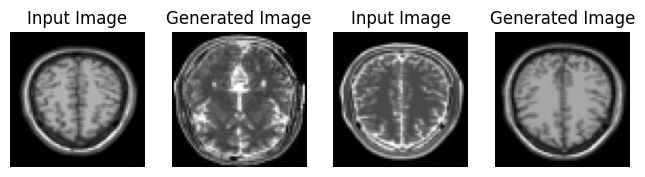

Saving checkpoint for epoch 3 at ./Trained_Model/ckpt-273


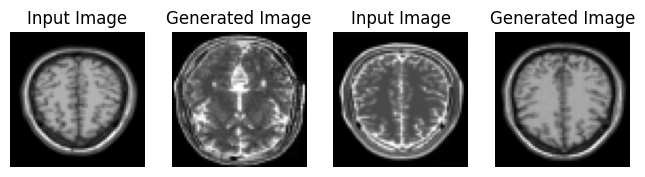

Saving checkpoint for epoch 4 at ./Trained_Model/ckpt-274


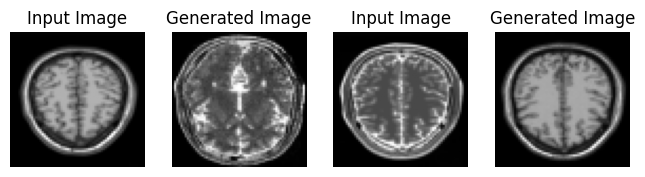

Saving checkpoint for epoch 5 at ./Trained_Model/ckpt-275


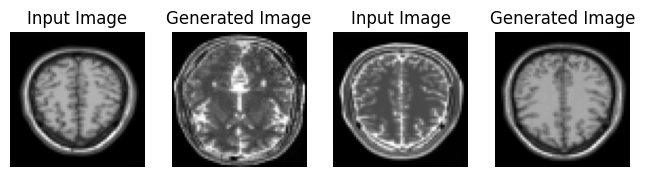

Saving checkpoint for epoch 6 at ./Trained_Model/ckpt-276


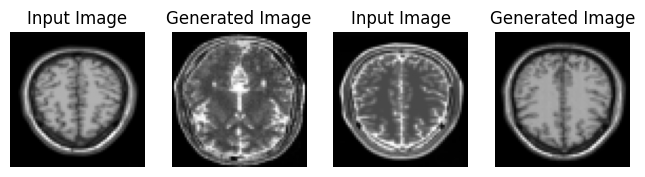

Saving checkpoint for epoch 7 at ./Trained_Model/ckpt-277


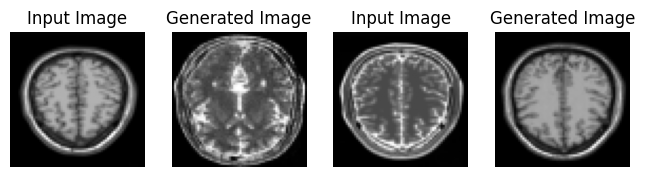

Saving checkpoint for epoch 8 at ./Trained_Model/ckpt-278


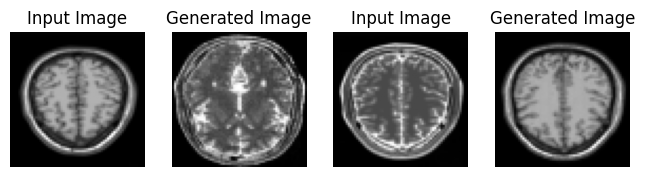

Saving checkpoint for epoch 9 at ./Trained_Model/ckpt-279


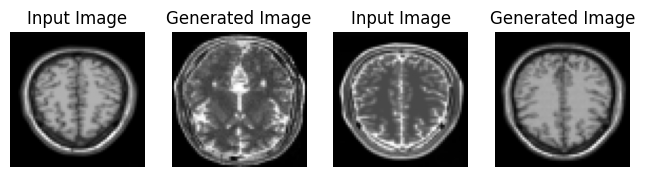

Saving checkpoint for epoch 10 at ./Trained_Model/ckpt-280


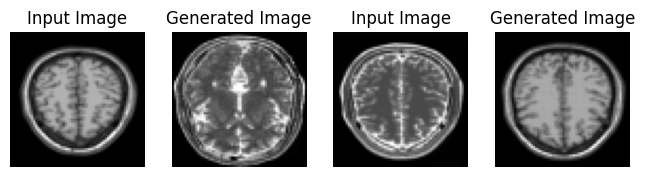

Saving checkpoint for epoch 11 at ./Trained_Model/ckpt-281


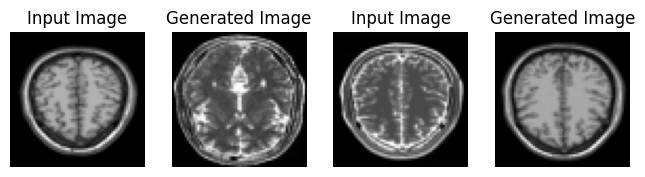

Saving checkpoint for epoch 12 at ./Trained_Model/ckpt-282


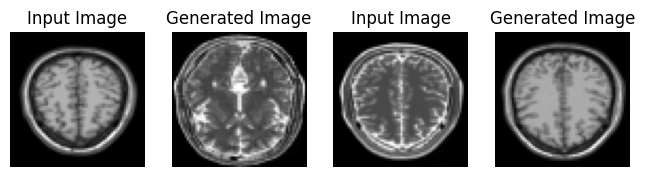

Saving checkpoint for epoch 13 at ./Trained_Model/ckpt-283


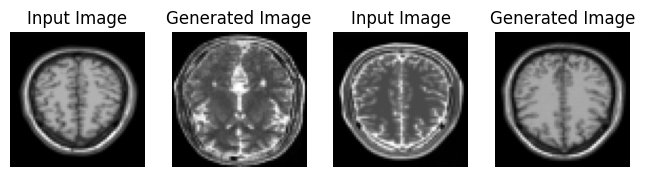

Saving checkpoint for epoch 14 at ./Trained_Model/ckpt-284


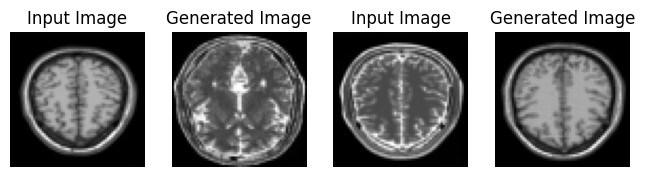

Saving checkpoint for epoch 15 at ./Trained_Model/ckpt-285


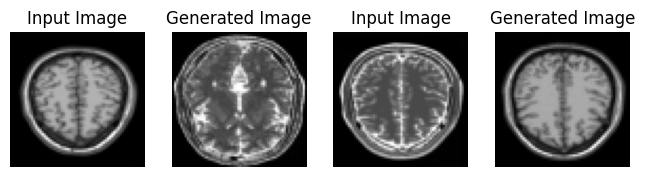

Saving checkpoint for epoch 16 at ./Trained_Model/ckpt-286


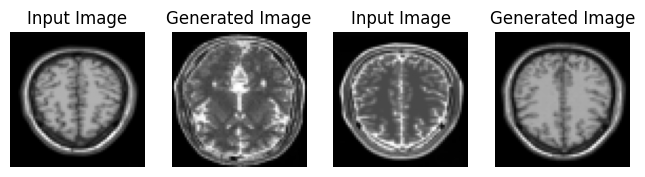

Saving checkpoint for epoch 17 at ./Trained_Model/ckpt-287


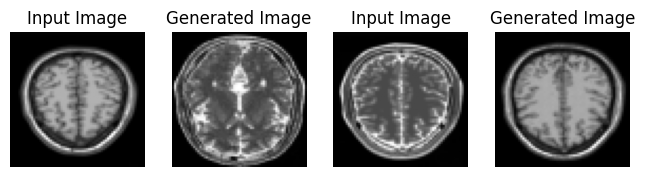

Saving checkpoint for epoch 18 at ./Trained_Model/ckpt-288


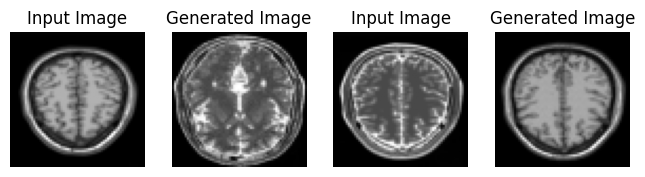

Saving checkpoint for epoch 19 at ./Trained_Model/ckpt-289


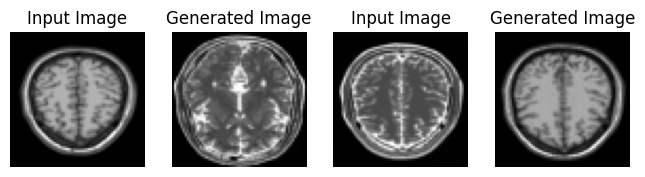

Saving checkpoint for epoch 20 at ./Trained_Model/ckpt-290


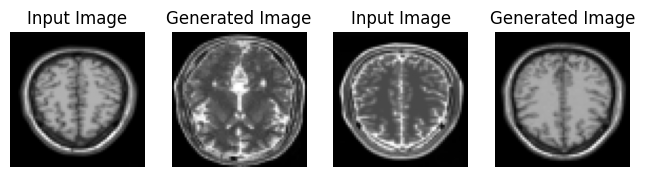

Saving checkpoint for epoch 21 at ./Trained_Model/ckpt-291


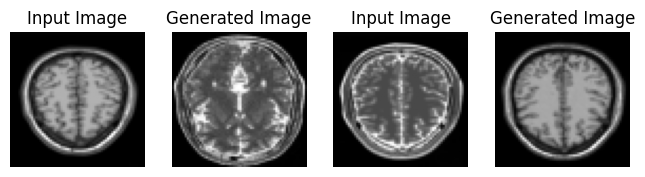

Saving checkpoint for epoch 22 at ./Trained_Model/ckpt-292


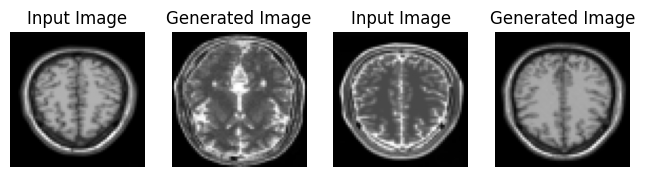

Saving checkpoint for epoch 23 at ./Trained_Model/ckpt-293


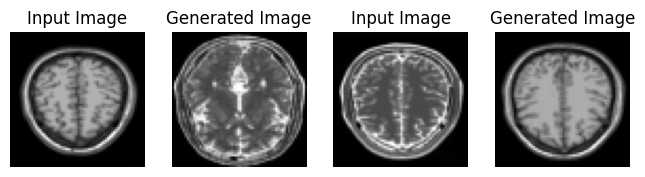

Saving checkpoint for epoch 24 at ./Trained_Model/ckpt-294


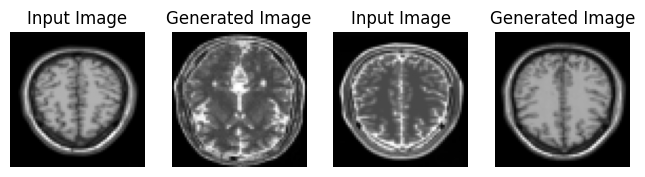

Saving checkpoint for epoch 25 at ./Trained_Model/ckpt-295


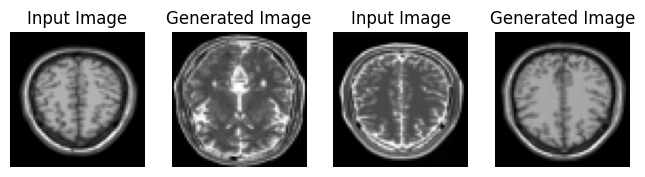

Saving checkpoint for epoch 26 at ./Trained_Model/ckpt-296


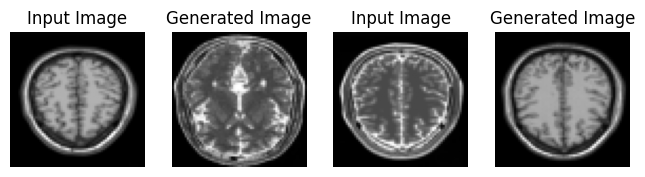

Saving checkpoint for epoch 27 at ./Trained_Model/ckpt-297


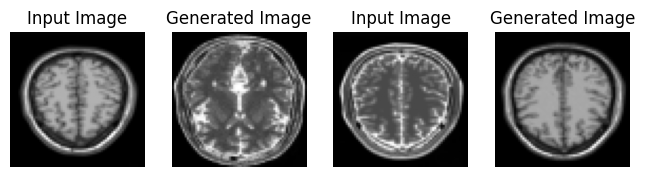

Saving checkpoint for epoch 28 at ./Trained_Model/ckpt-298


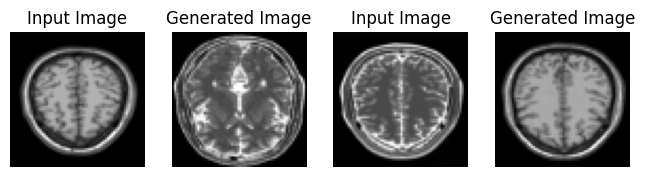

Saving checkpoint for epoch 29 at ./Trained_Model/ckpt-299


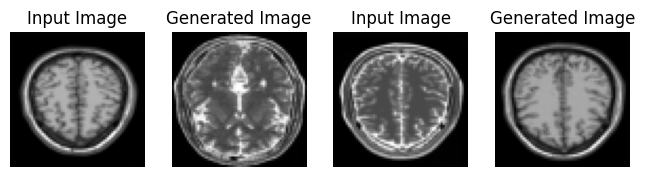

Saving checkpoint for epoch 30 at ./Trained_Model/ckpt-300


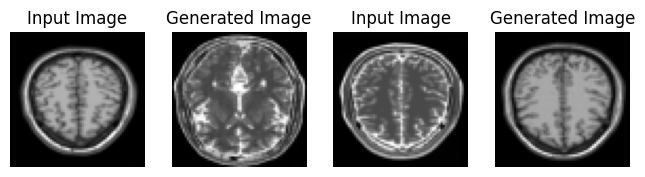

Saving checkpoint for epoch 31 at ./Trained_Model/ckpt-301


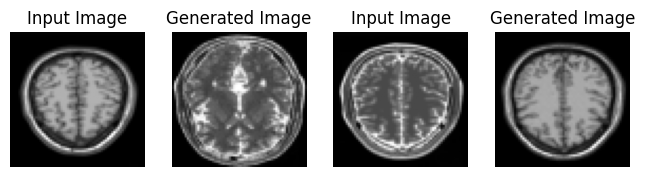

Saving checkpoint for epoch 32 at ./Trained_Model/ckpt-302


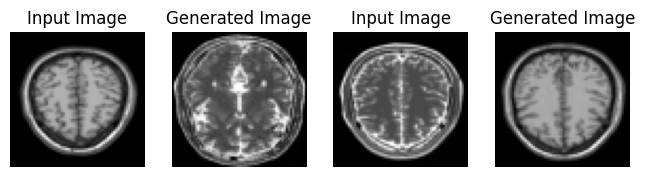

Saving checkpoint for epoch 33 at ./Trained_Model/ckpt-303


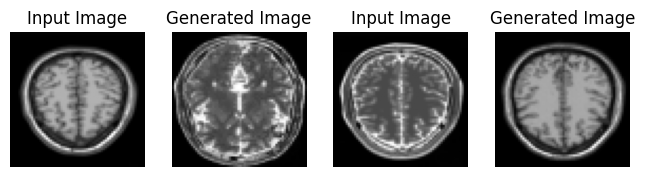

Saving checkpoint for epoch 34 at ./Trained_Model/ckpt-304


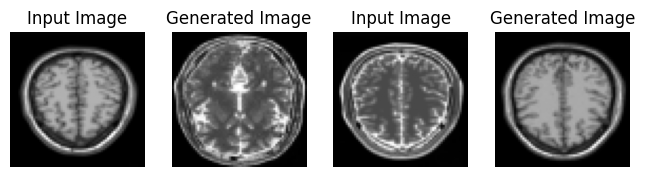

Saving checkpoint for epoch 35 at ./Trained_Model/ckpt-305


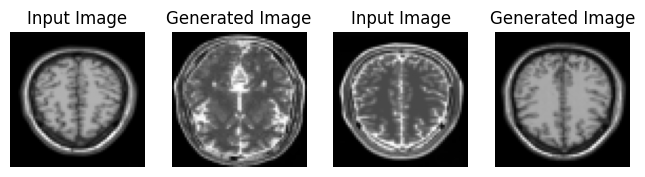

Saving checkpoint for epoch 36 at ./Trained_Model/ckpt-306


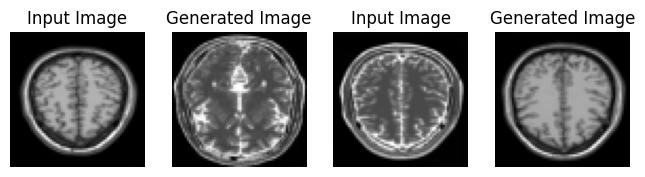

Saving checkpoint for epoch 37 at ./Trained_Model/ckpt-307


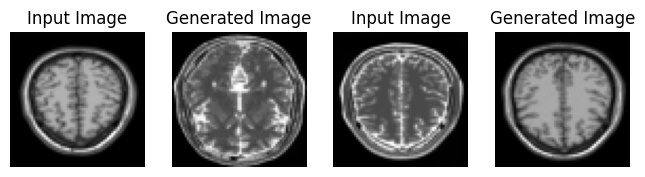

Saving checkpoint for epoch 38 at ./Trained_Model/ckpt-308


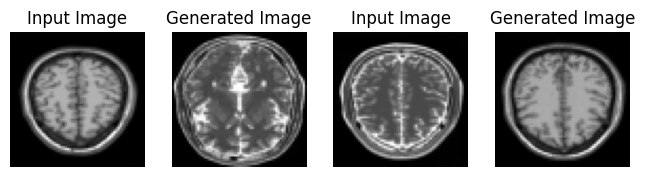

Saving checkpoint for epoch 39 at ./Trained_Model/ckpt-309


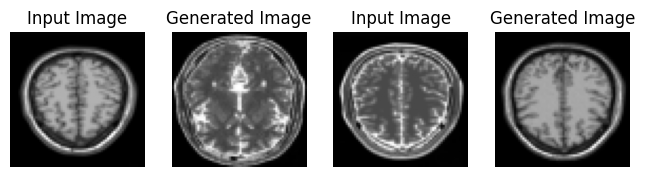

Saving checkpoint for epoch 40 at ./Trained_Model/ckpt-310


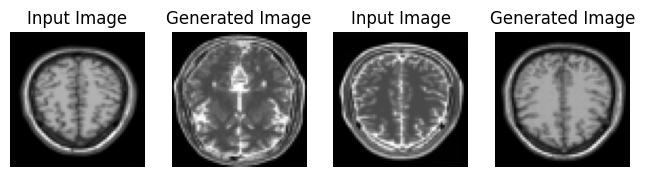

Saving checkpoint for epoch 41 at ./Trained_Model/ckpt-311


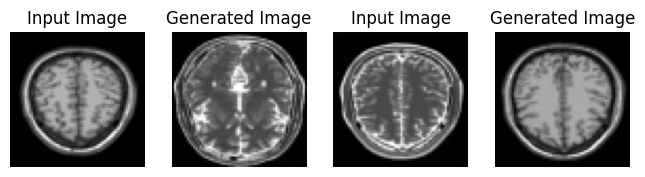

Saving checkpoint for epoch 42 at ./Trained_Model/ckpt-312


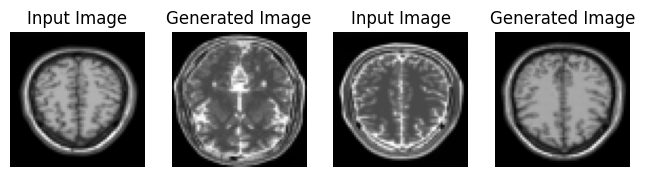

Saving checkpoint for epoch 43 at ./Trained_Model/ckpt-313


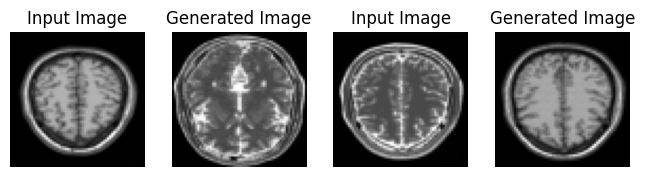

Saving checkpoint for epoch 44 at ./Trained_Model/ckpt-314


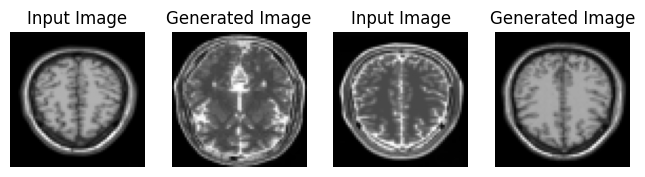

Saving checkpoint for epoch 45 at ./Trained_Model/ckpt-315


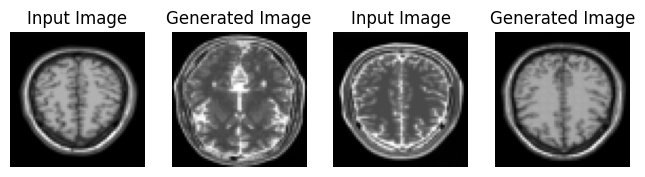

Saving checkpoint for epoch 46 at ./Trained_Model/ckpt-316


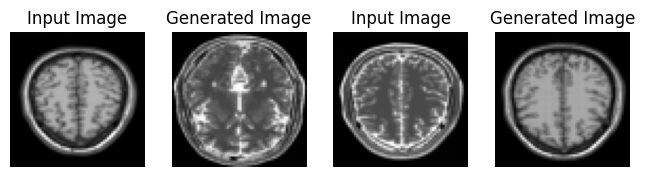

Saving checkpoint for epoch 47 at ./Trained_Model/ckpt-317


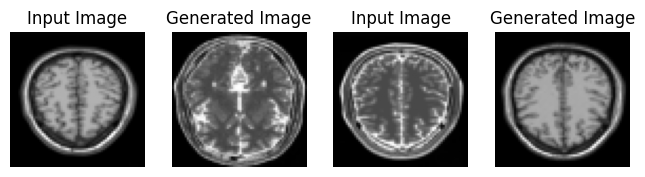

Saving checkpoint for epoch 48 at ./Trained_Model/ckpt-318


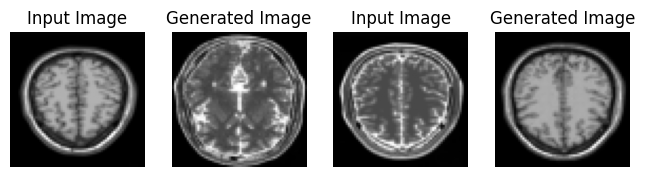

Saving checkpoint for epoch 49 at ./Trained_Model/ckpt-319


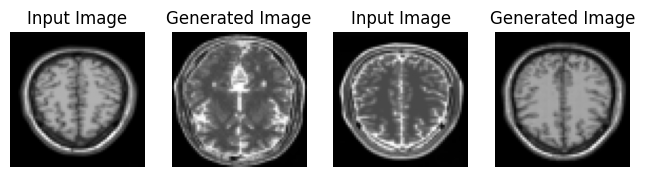

Saving checkpoint for epoch 50 at ./Trained_Model/ckpt-320


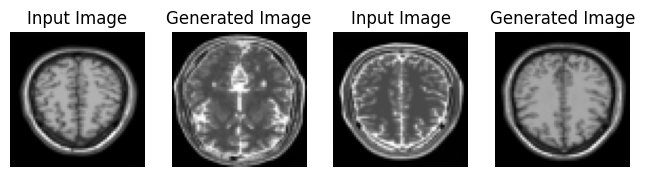

Saving checkpoint for epoch 51 at ./Trained_Model/ckpt-321


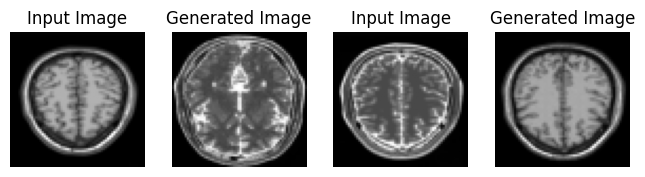

Saving checkpoint for epoch 52 at ./Trained_Model/ckpt-322


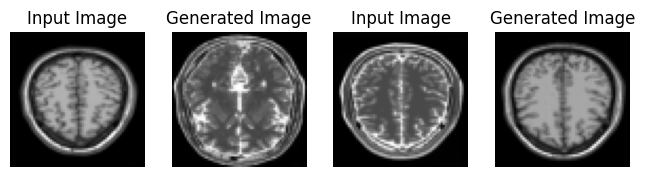

Saving checkpoint for epoch 53 at ./Trained_Model/ckpt-323


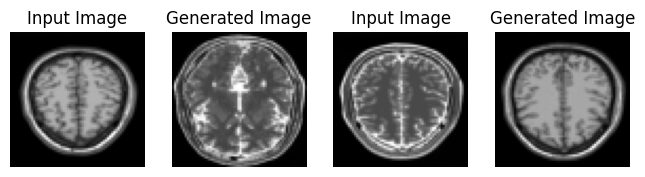

Saving checkpoint for epoch 54 at ./Trained_Model/ckpt-324


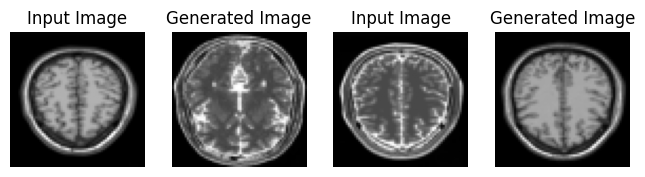

Saving checkpoint for epoch 55 at ./Trained_Model/ckpt-325


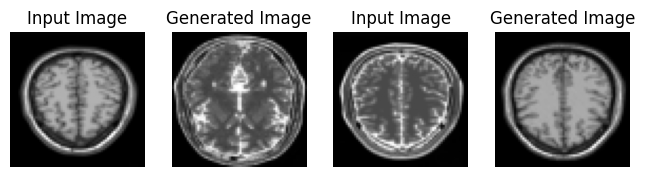

Saving checkpoint for epoch 56 at ./Trained_Model/ckpt-326


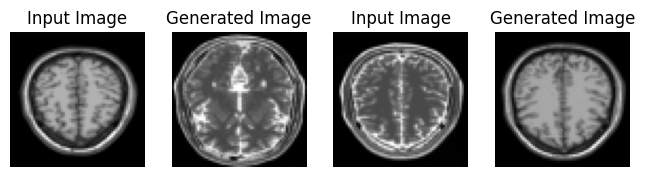

Saving checkpoint for epoch 57 at ./Trained_Model/ckpt-327


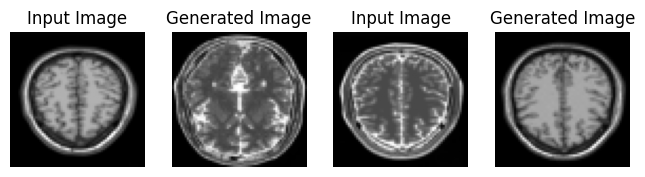

Saving checkpoint for epoch 58 at ./Trained_Model/ckpt-328


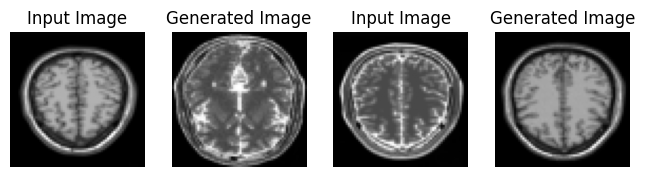

Saving checkpoint for epoch 59 at ./Trained_Model/ckpt-329


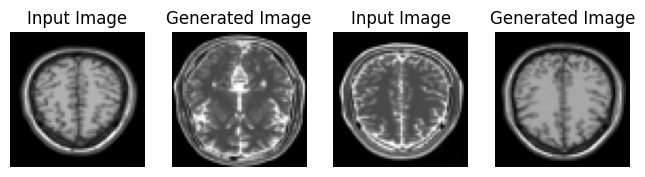

Saving checkpoint for epoch 60 at ./Trained_Model/ckpt-330


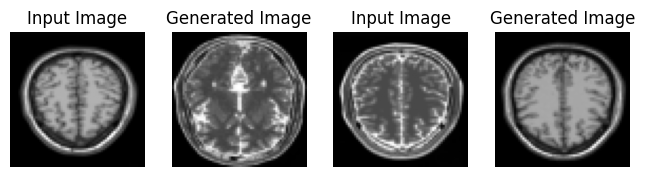

Saving checkpoint for epoch 61 at ./Trained_Model/ckpt-331


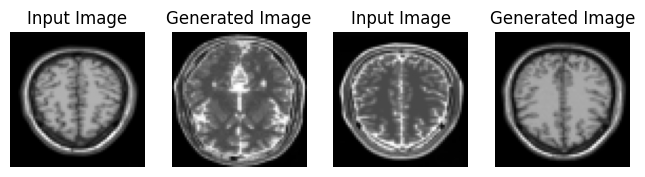

Saving checkpoint for epoch 62 at ./Trained_Model/ckpt-332


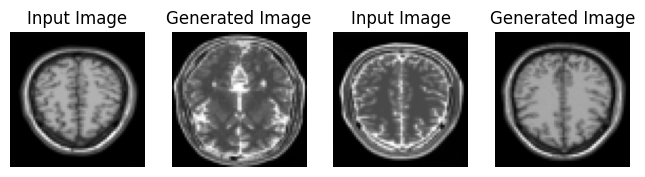

Saving checkpoint for epoch 63 at ./Trained_Model/ckpt-333


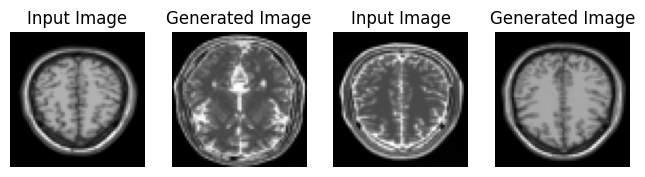

Saving checkpoint for epoch 64 at ./Trained_Model/ckpt-334


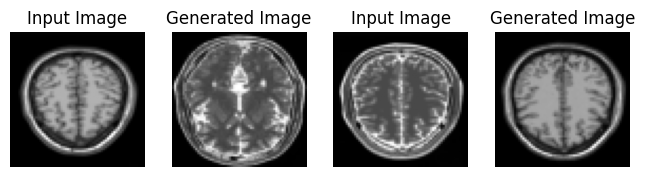

Saving checkpoint for epoch 65 at ./Trained_Model/ckpt-335


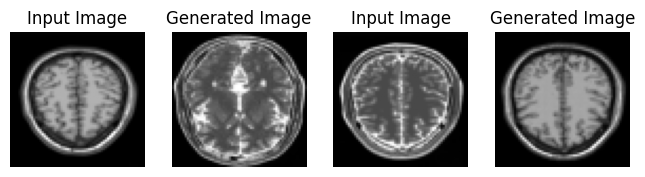

Saving checkpoint for epoch 66 at ./Trained_Model/ckpt-336


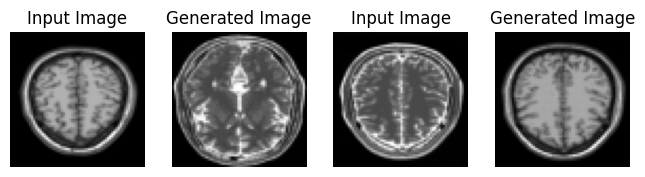

Saving checkpoint for epoch 67 at ./Trained_Model/ckpt-337


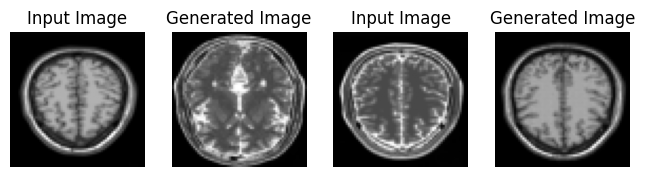

Saving checkpoint for epoch 68 at ./Trained_Model/ckpt-338


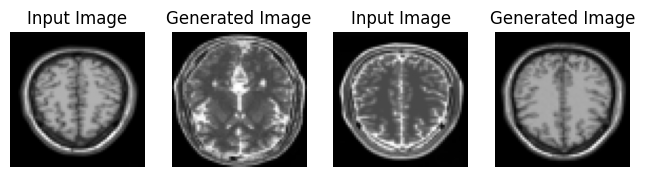

Saving checkpoint for epoch 69 at ./Trained_Model/ckpt-339


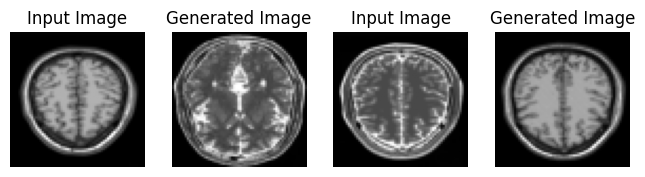

Saving checkpoint for epoch 70 at ./Trained_Model/ckpt-340


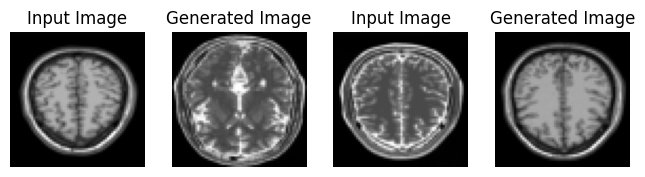

Saving checkpoint for epoch 71 at ./Trained_Model/ckpt-341


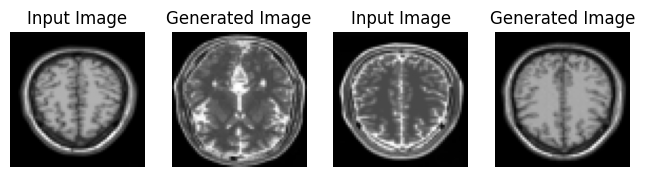

Saving checkpoint for epoch 72 at ./Trained_Model/ckpt-342


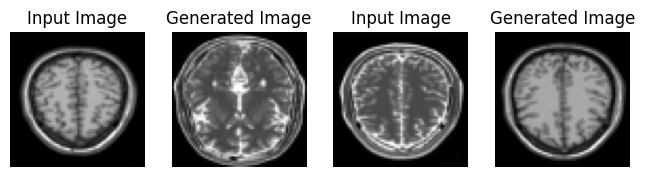

Saving checkpoint for epoch 73 at ./Trained_Model/ckpt-343


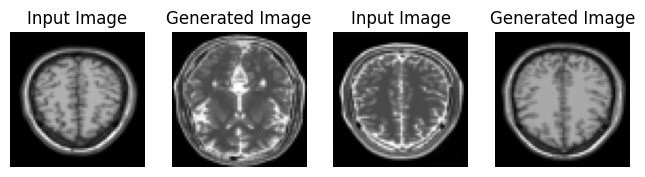

Saving checkpoint for epoch 74 at ./Trained_Model/ckpt-344


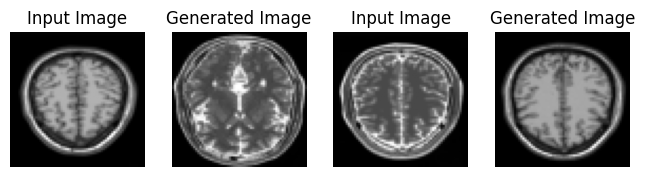

Saving checkpoint for epoch 75 at ./Trained_Model/ckpt-345


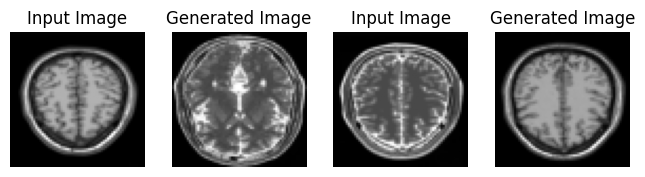

Saving checkpoint for epoch 76 at ./Trained_Model/ckpt-346


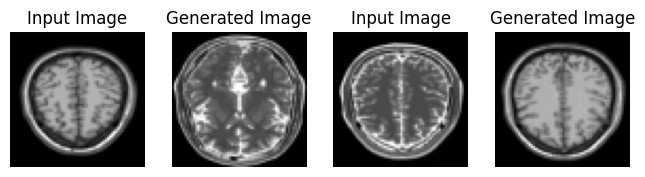

Saving checkpoint for epoch 77 at ./Trained_Model/ckpt-347


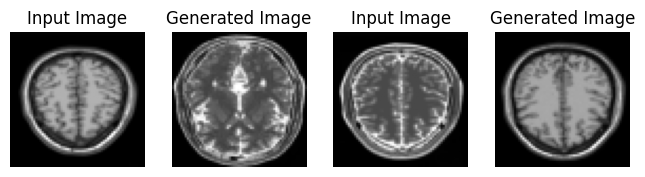

Saving checkpoint for epoch 78 at ./Trained_Model/ckpt-348


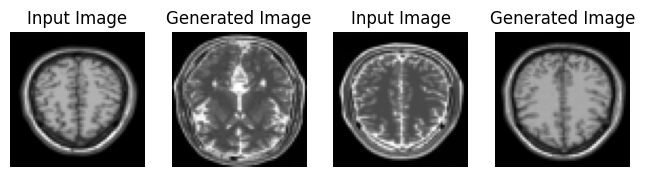

Saving checkpoint for epoch 79 at ./Trained_Model/ckpt-349


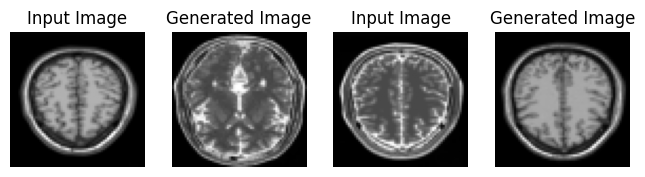

Saving checkpoint for epoch 80 at ./Trained_Model/ckpt-350


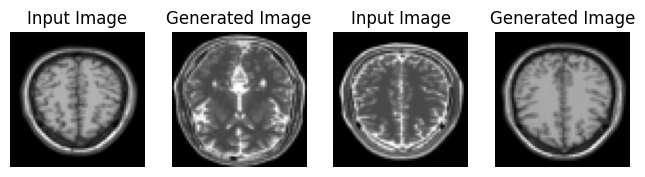

Saving checkpoint for epoch 81 at ./Trained_Model/ckpt-351


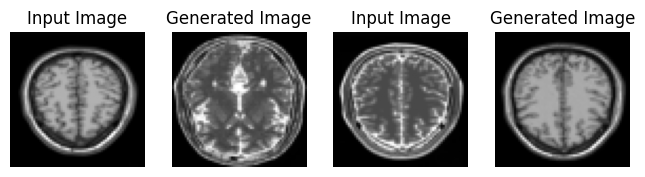

Saving checkpoint for epoch 82 at ./Trained_Model/ckpt-352


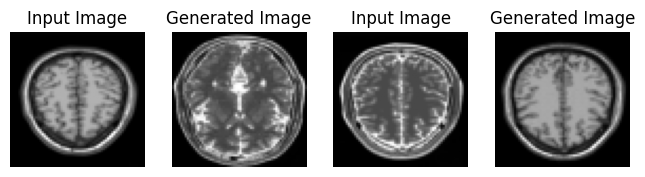

Saving checkpoint for epoch 83 at ./Trained_Model/ckpt-353


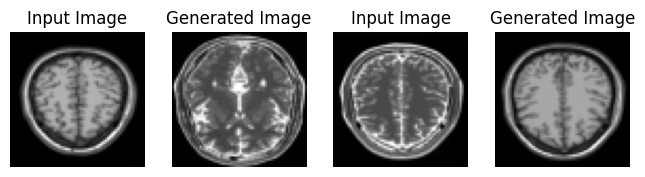

Saving checkpoint for epoch 84 at ./Trained_Model/ckpt-354


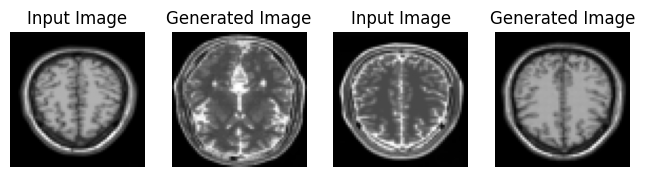

Saving checkpoint for epoch 85 at ./Trained_Model/ckpt-355


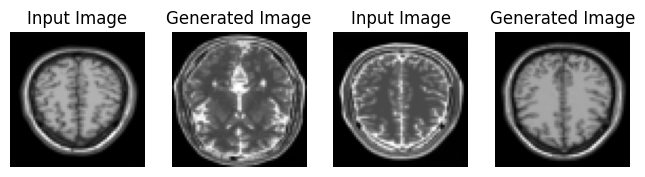

Saving checkpoint for epoch 86 at ./Trained_Model/ckpt-356


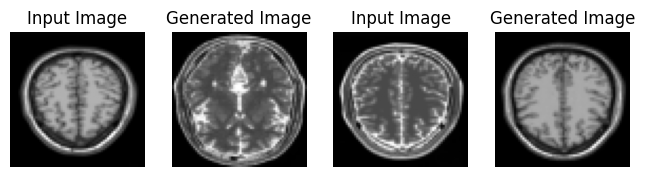

Saving checkpoint for epoch 87 at ./Trained_Model/ckpt-357


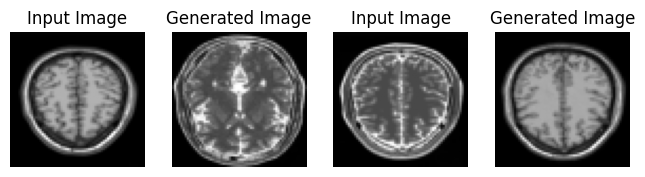

Saving checkpoint for epoch 88 at ./Trained_Model/ckpt-358


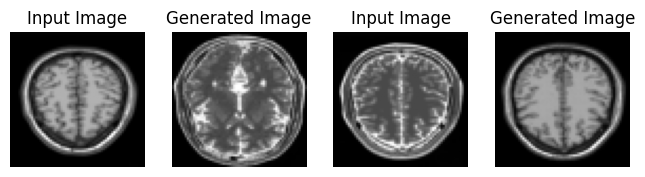

Saving checkpoint for epoch 89 at ./Trained_Model/ckpt-359


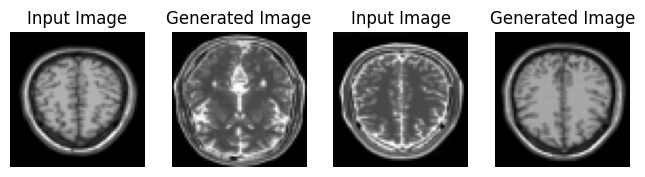

Saving checkpoint for epoch 90 at ./Trained_Model/ckpt-360


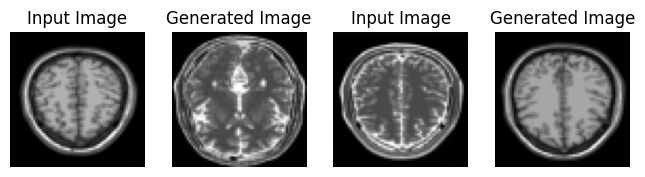

Saving checkpoint for epoch 91 at ./Trained_Model/ckpt-361


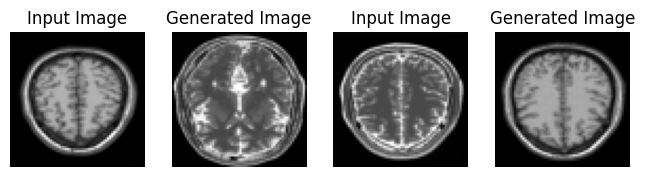

Saving checkpoint for epoch 92 at ./Trained_Model/ckpt-362


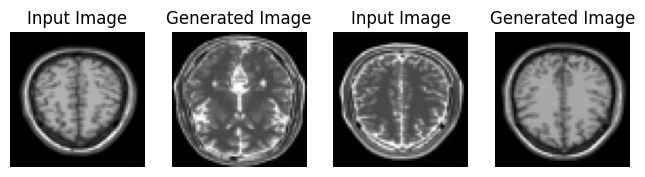

Saving checkpoint for epoch 93 at ./Trained_Model/ckpt-363


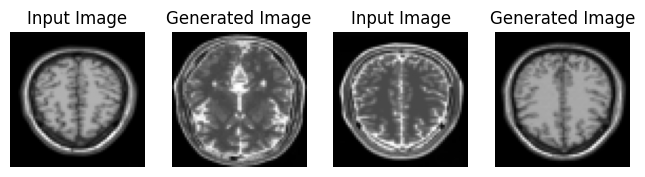

Saving checkpoint for epoch 94 at ./Trained_Model/ckpt-364


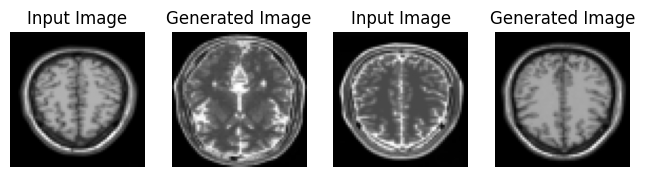

Saving checkpoint for epoch 95 at ./Trained_Model/ckpt-365


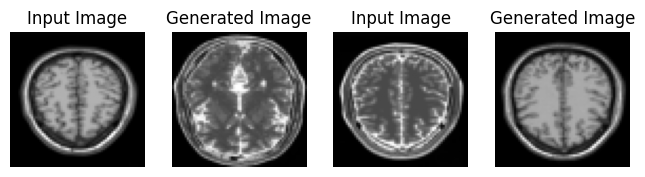

Saving checkpoint for epoch 96 at ./Trained_Model/ckpt-366


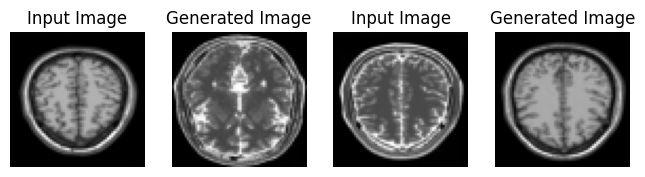

Saving checkpoint for epoch 97 at ./Trained_Model/ckpt-367


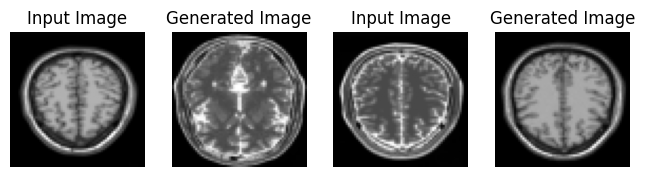

Saving checkpoint for epoch 98 at ./Trained_Model/ckpt-368


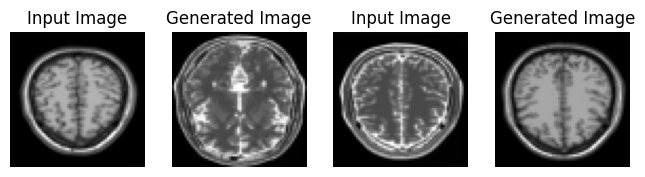

Saving checkpoint for epoch 99 at ./Trained_Model/ckpt-369


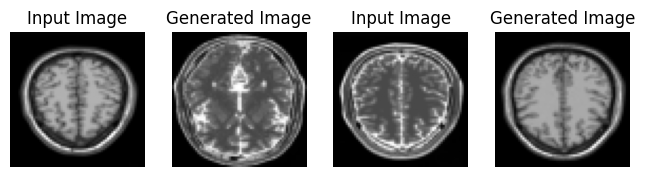

Saving checkpoint for epoch 100 at ./Trained_Model/ckpt-370


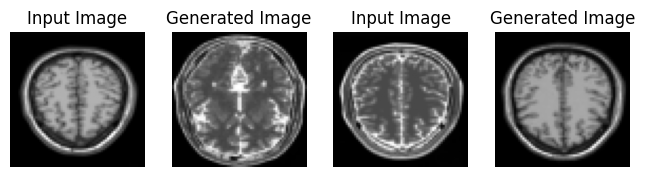

Saving checkpoint for epoch 101 at ./Trained_Model/ckpt-371


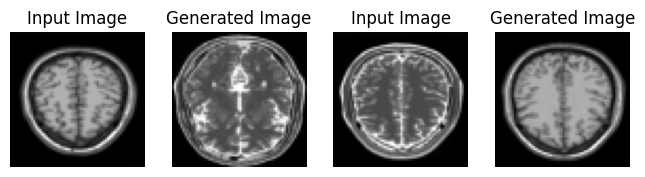

Saving checkpoint for epoch 102 at ./Trained_Model/ckpt-372


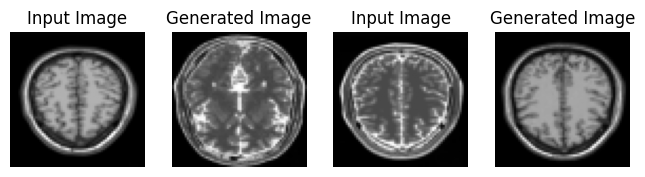

Saving checkpoint for epoch 103 at ./Trained_Model/ckpt-373


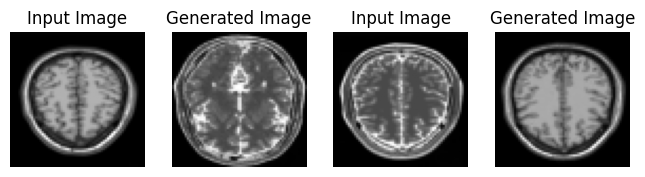

Saving checkpoint for epoch 104 at ./Trained_Model/ckpt-374


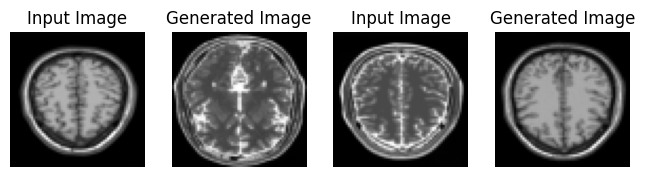

Saving checkpoint for epoch 105 at ./Trained_Model/ckpt-375


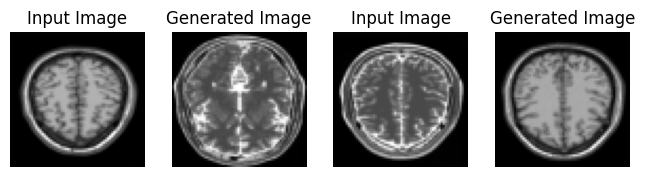

Saving checkpoint for epoch 106 at ./Trained_Model/ckpt-376


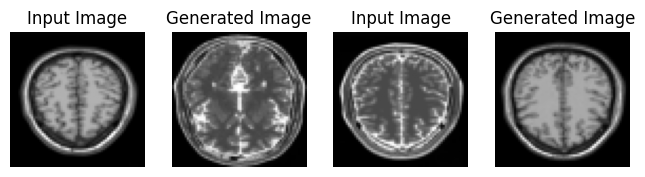

Saving checkpoint for epoch 107 at ./Trained_Model/ckpt-377


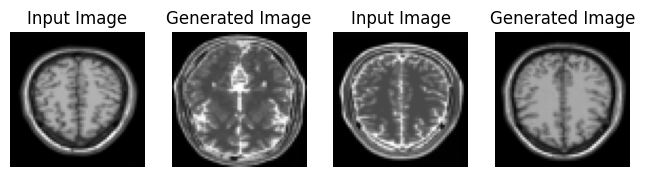

Saving checkpoint for epoch 108 at ./Trained_Model/ckpt-378


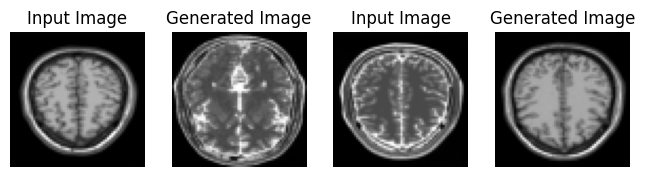

Saving checkpoint for epoch 109 at ./Trained_Model/ckpt-379


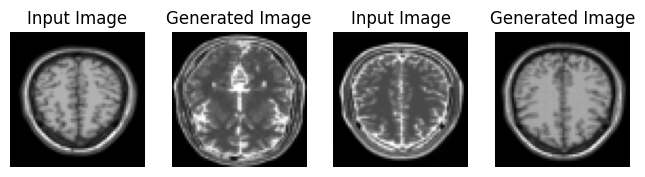

Saving checkpoint for epoch 110 at ./Trained_Model/ckpt-380


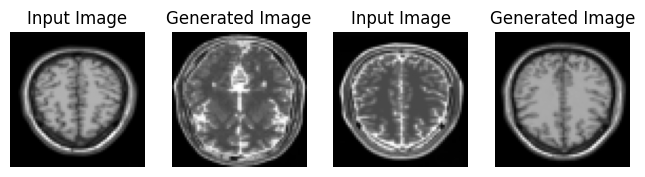

Saving checkpoint for epoch 111 at ./Trained_Model/ckpt-381


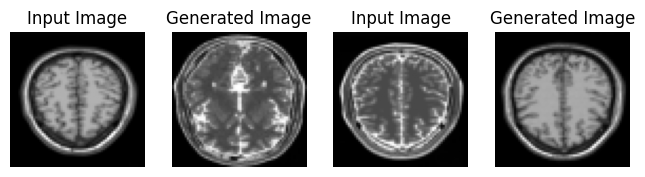

Saving checkpoint for epoch 112 at ./Trained_Model/ckpt-382


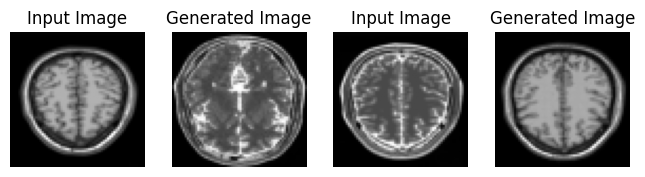

Saving checkpoint for epoch 113 at ./Trained_Model/ckpt-383


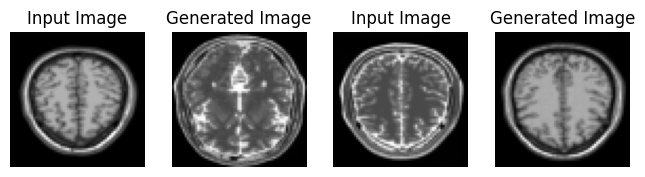

Saving checkpoint for epoch 114 at ./Trained_Model/ckpt-384


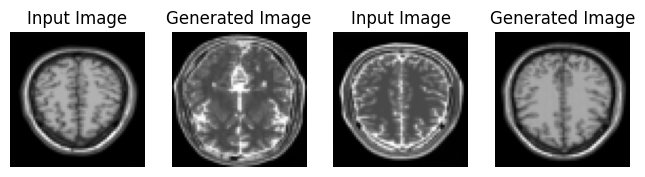

Saving checkpoint for epoch 115 at ./Trained_Model/ckpt-385


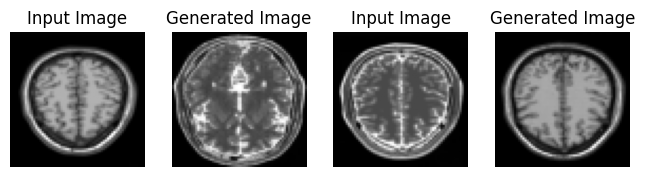

Saving checkpoint for epoch 116 at ./Trained_Model/ckpt-386


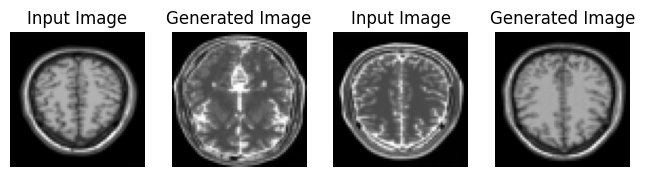

Saving checkpoint for epoch 117 at ./Trained_Model/ckpt-387


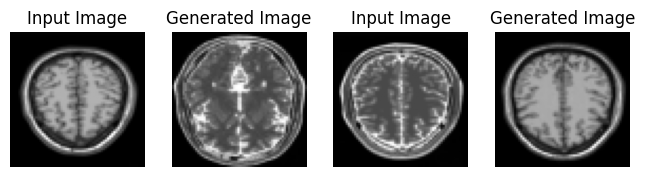

Saving checkpoint for epoch 118 at ./Trained_Model/ckpt-388


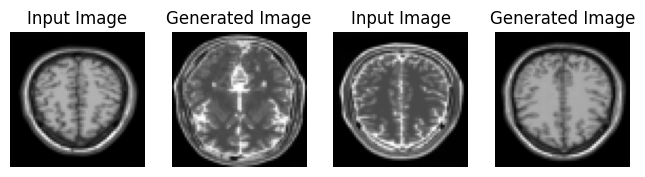

Saving checkpoint for epoch 119 at ./Trained_Model/ckpt-389


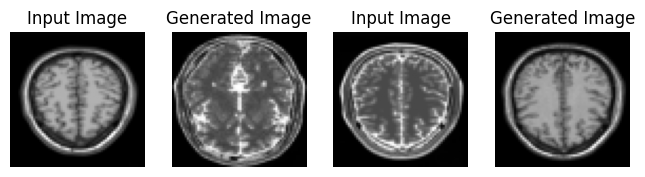

Saving checkpoint for epoch 120 at ./Trained_Model/ckpt-390


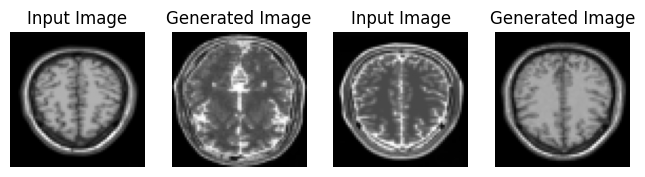

Saving checkpoint for epoch 121 at ./Trained_Model/ckpt-391


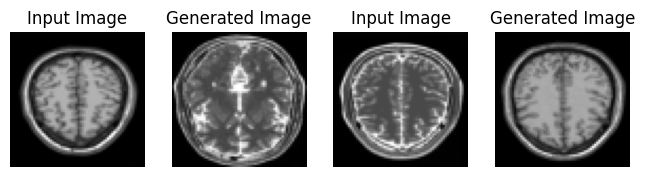

Saving checkpoint for epoch 122 at ./Trained_Model/ckpt-392


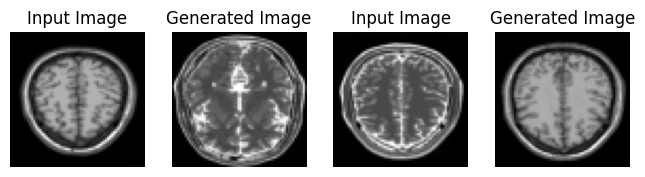

Saving checkpoint for epoch 123 at ./Trained_Model/ckpt-393


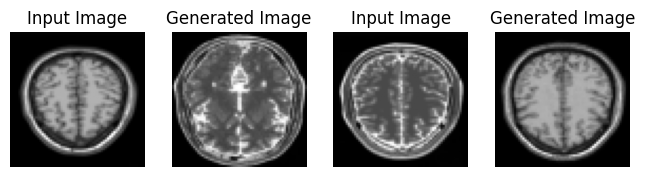

Saving checkpoint for epoch 124 at ./Trained_Model/ckpt-394


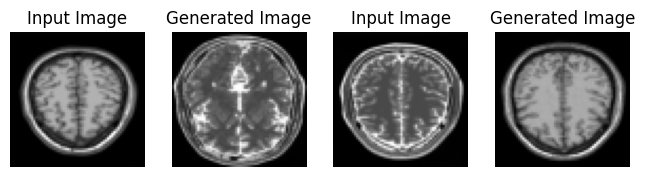

Saving checkpoint for epoch 125 at ./Trained_Model/ckpt-395


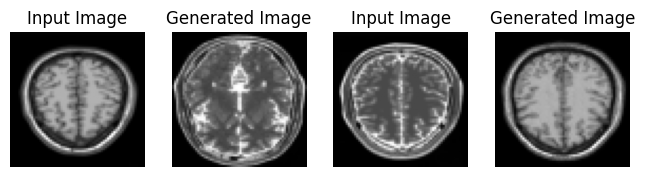

Saving checkpoint for epoch 126 at ./Trained_Model/ckpt-396


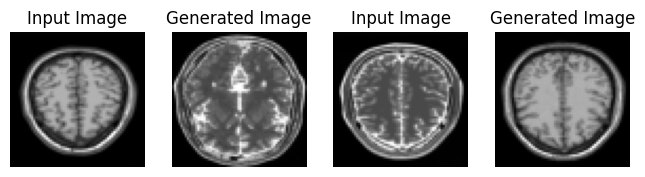

Saving checkpoint for epoch 127 at ./Trained_Model/ckpt-397


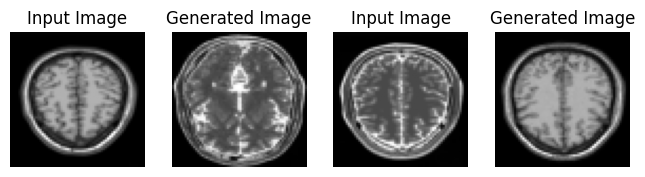

Saving checkpoint for epoch 128 at ./Trained_Model/ckpt-398


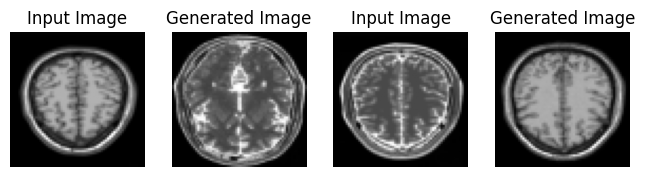

Saving checkpoint for epoch 129 at ./Trained_Model/ckpt-399


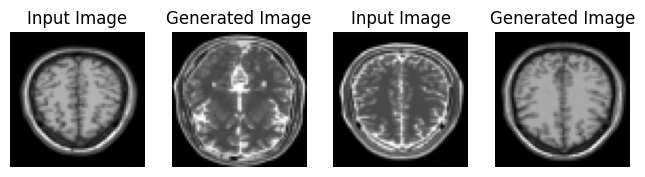

Saving checkpoint for epoch 130 at ./Trained_Model/ckpt-400


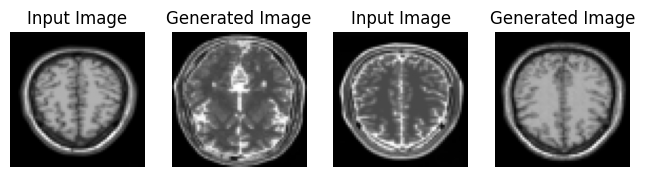

Saving checkpoint for epoch 131 at ./Trained_Model/ckpt-401


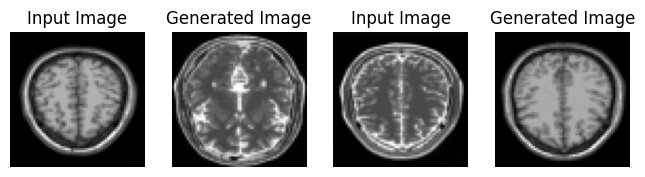

Saving checkpoint for epoch 132 at ./Trained_Model/ckpt-402


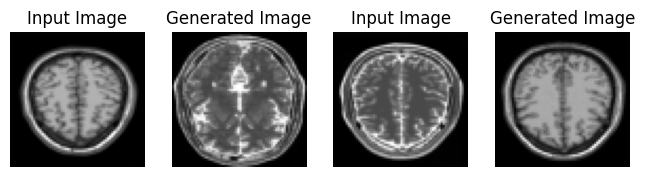

Saving checkpoint for epoch 133 at ./Trained_Model/ckpt-403


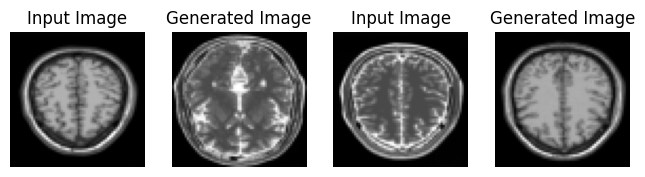

Saving checkpoint for epoch 134 at ./Trained_Model/ckpt-404


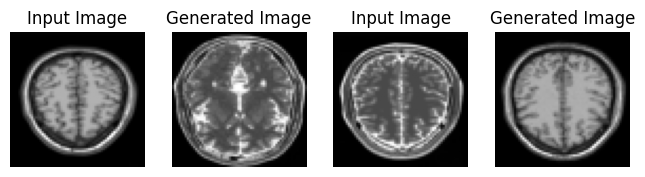

Saving checkpoint for epoch 135 at ./Trained_Model/ckpt-405


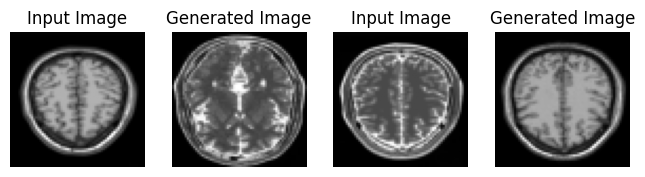

Saving checkpoint for epoch 136 at ./Trained_Model/ckpt-406


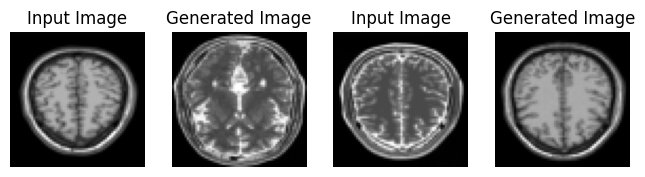

Saving checkpoint for epoch 137 at ./Trained_Model/ckpt-407


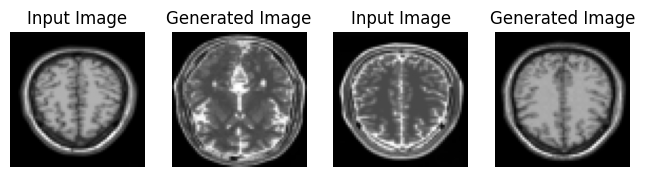

Saving checkpoint for epoch 138 at ./Trained_Model/ckpt-408


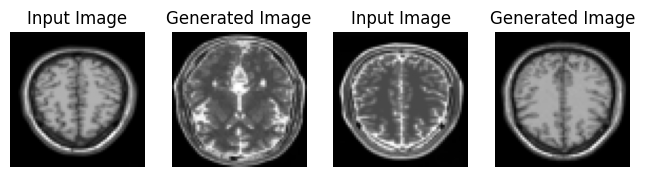

Saving checkpoint for epoch 139 at ./Trained_Model/ckpt-409


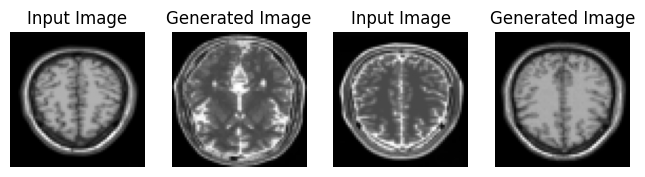

Saving checkpoint for epoch 140 at ./Trained_Model/ckpt-410


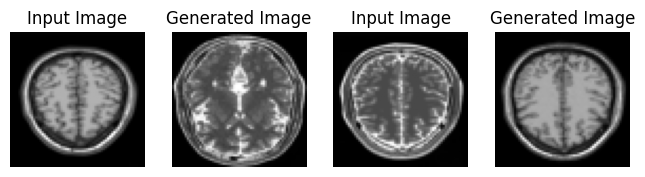

Saving checkpoint for epoch 141 at ./Trained_Model/ckpt-411


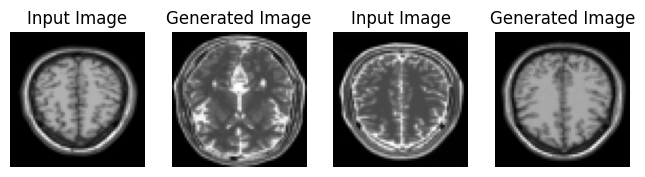

Saving checkpoint for epoch 142 at ./Trained_Model/ckpt-412


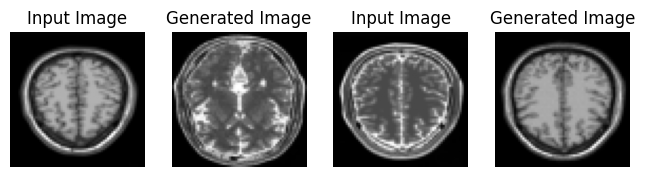

Saving checkpoint for epoch 143 at ./Trained_Model/ckpt-413


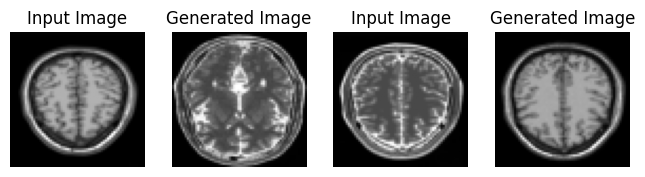

Saving checkpoint for epoch 144 at ./Trained_Model/ckpt-414


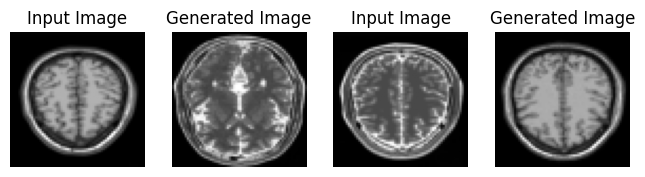

Saving checkpoint for epoch 145 at ./Trained_Model/ckpt-415


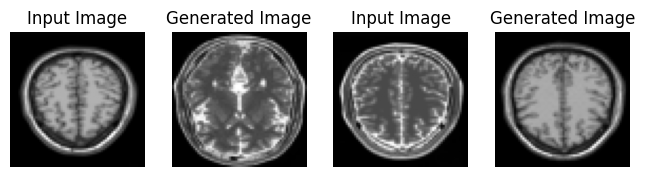

Saving checkpoint for epoch 146 at ./Trained_Model/ckpt-416


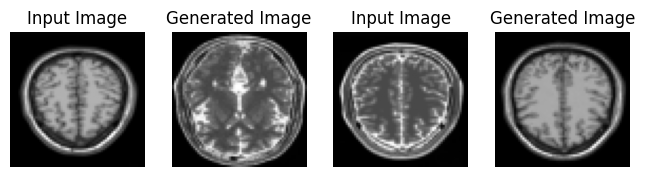

Saving checkpoint for epoch 147 at ./Trained_Model/ckpt-417


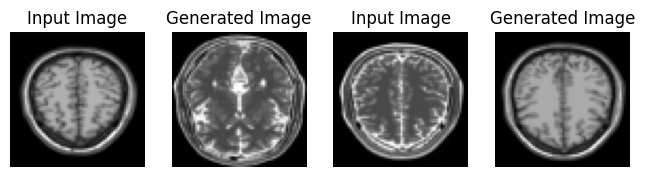

Saving checkpoint for epoch 148 at ./Trained_Model/ckpt-418


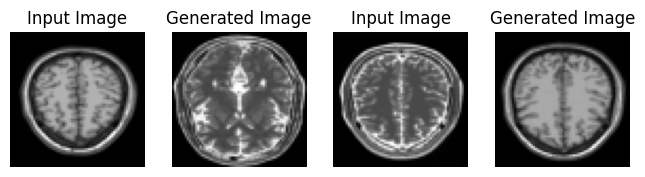

Saving checkpoint for epoch 149 at ./Trained_Model/ckpt-419


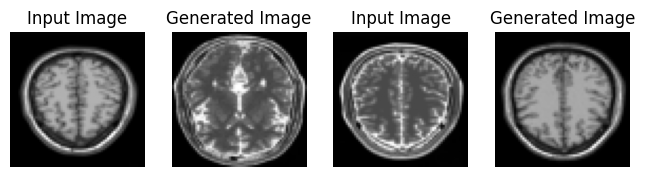

Saving checkpoint for epoch 150 at ./Trained_Model/ckpt-420


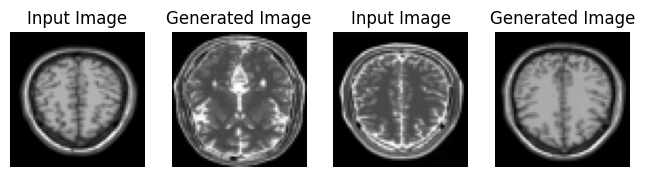

Saving checkpoint for epoch 151 at ./Trained_Model/ckpt-421


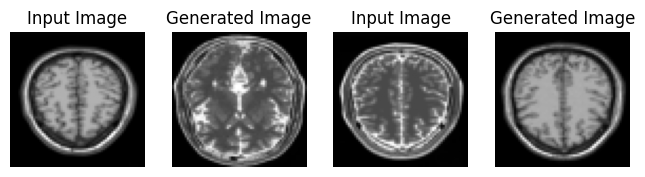

Saving checkpoint for epoch 152 at ./Trained_Model/ckpt-422


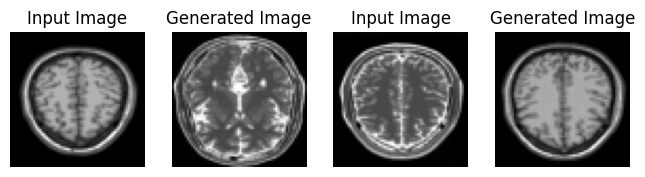

Saving checkpoint for epoch 153 at ./Trained_Model/ckpt-423


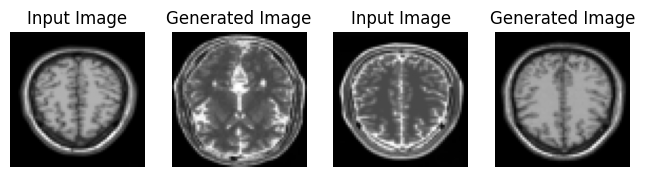

Saving checkpoint for epoch 154 at ./Trained_Model/ckpt-424


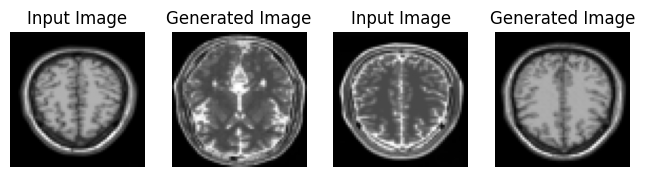

Saving checkpoint for epoch 155 at ./Trained_Model/ckpt-425


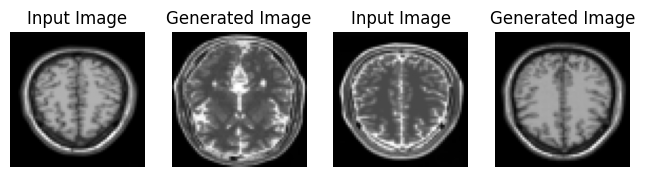

Saving checkpoint for epoch 156 at ./Trained_Model/ckpt-426


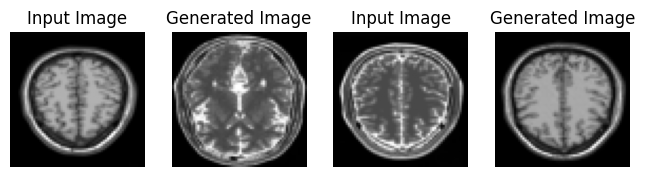

Saving checkpoint for epoch 157 at ./Trained_Model/ckpt-427


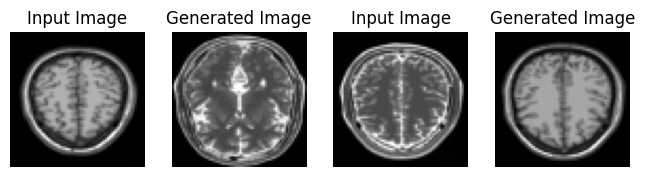

Saving checkpoint for epoch 158 at ./Trained_Model/ckpt-428


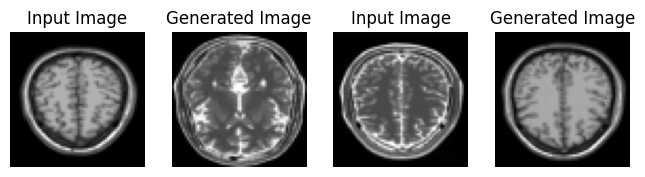

Saving checkpoint for epoch 159 at ./Trained_Model/ckpt-429


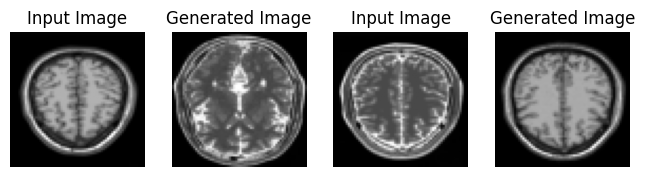

Saving checkpoint for epoch 160 at ./Trained_Model/ckpt-430


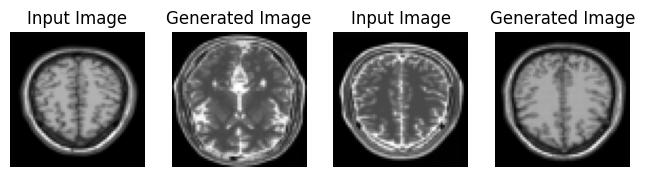

Saving checkpoint for epoch 161 at ./Trained_Model/ckpt-431


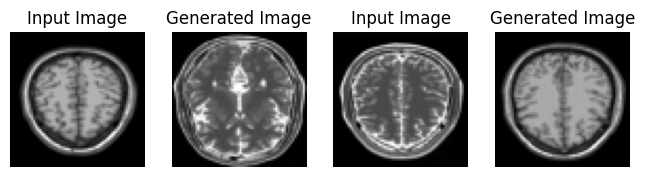

Saving checkpoint for epoch 162 at ./Trained_Model/ckpt-432


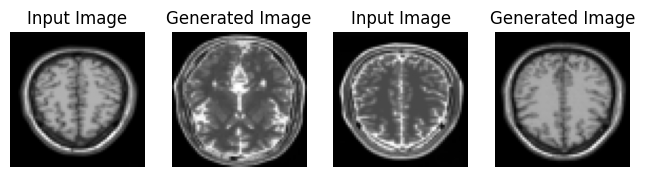

Saving checkpoint for epoch 163 at ./Trained_Model/ckpt-433


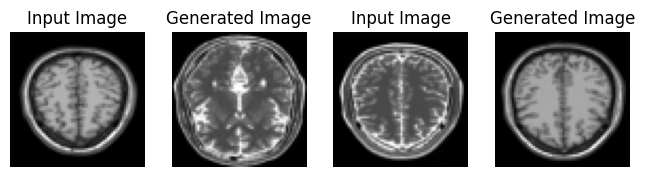

Saving checkpoint for epoch 164 at ./Trained_Model/ckpt-434


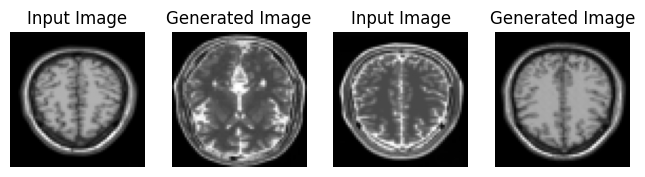

Saving checkpoint for epoch 165 at ./Trained_Model/ckpt-435


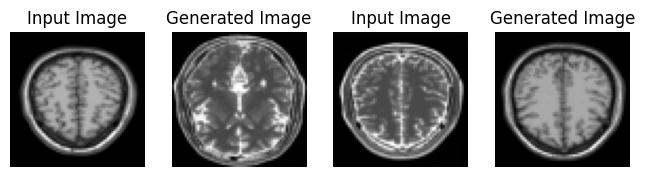

Saving checkpoint for epoch 166 at ./Trained_Model/ckpt-436


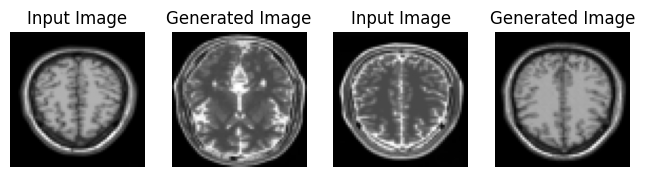

Saving checkpoint for epoch 167 at ./Trained_Model/ckpt-437


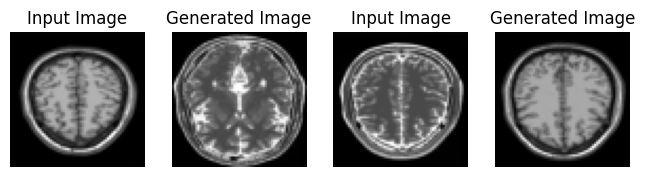

Saving checkpoint for epoch 168 at ./Trained_Model/ckpt-438


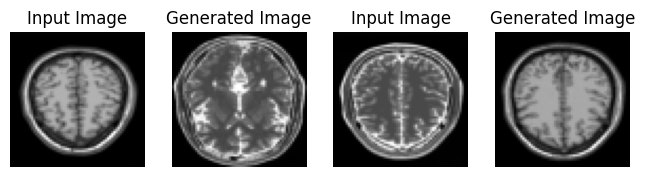

Saving checkpoint for epoch 169 at ./Trained_Model/ckpt-439


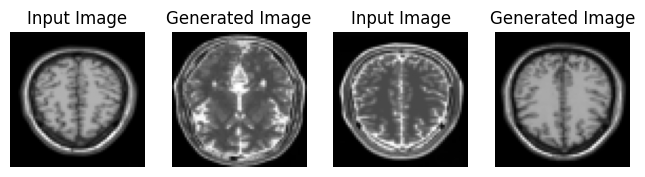

Saving checkpoint for epoch 170 at ./Trained_Model/ckpt-440


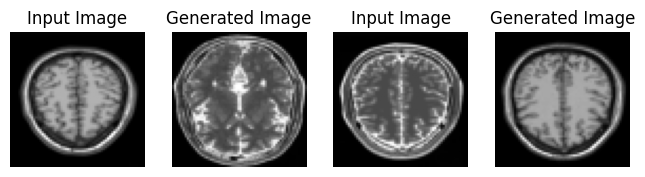

Saving checkpoint for epoch 171 at ./Trained_Model/ckpt-441


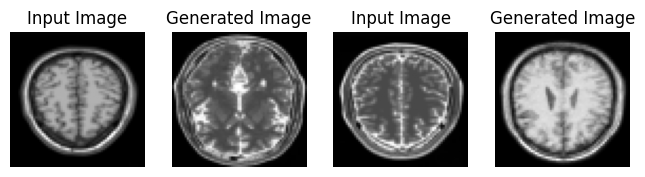

Saving checkpoint for epoch 172 at ./Trained_Model/ckpt-442


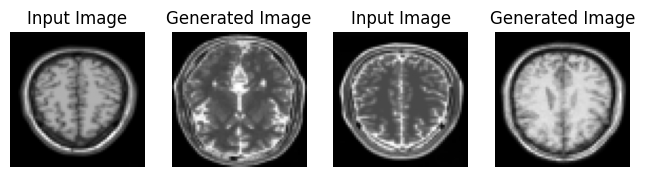

Saving checkpoint for epoch 173 at ./Trained_Model/ckpt-443


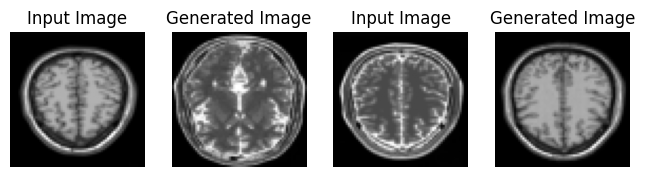

Saving checkpoint for epoch 174 at ./Trained_Model/ckpt-444


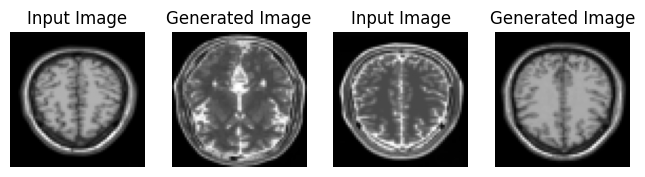

Saving checkpoint for epoch 175 at ./Trained_Model/ckpt-445


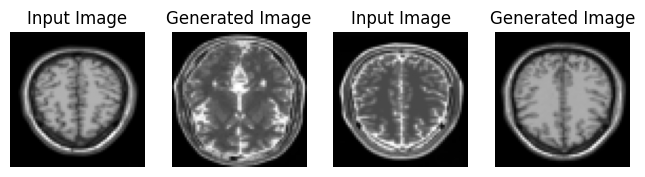

Saving checkpoint for epoch 176 at ./Trained_Model/ckpt-446


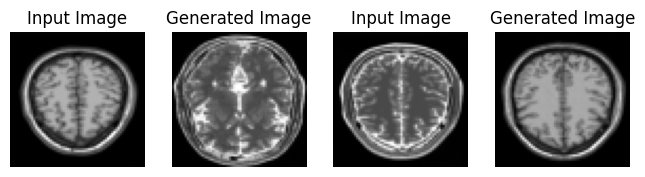

Saving checkpoint for epoch 177 at ./Trained_Model/ckpt-447


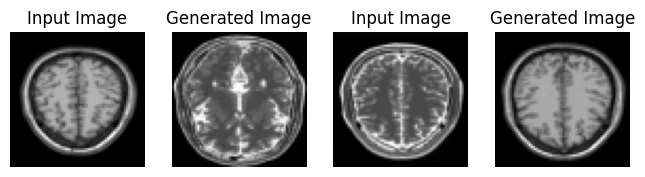

Saving checkpoint for epoch 178 at ./Trained_Model/ckpt-448


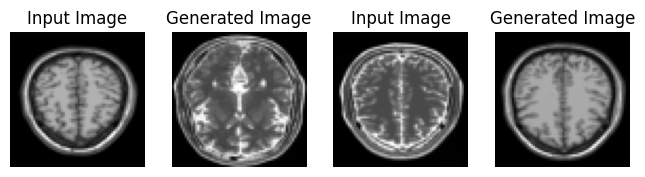

Saving checkpoint for epoch 179 at ./Trained_Model/ckpt-449


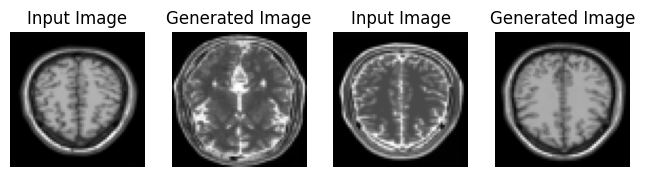

Saving checkpoint for epoch 180 at ./Trained_Model/ckpt-450


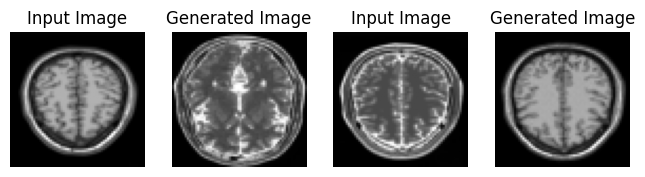

Saving checkpoint for epoch 181 at ./Trained_Model/ckpt-451


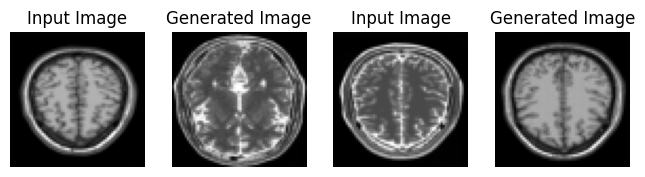

Saving checkpoint for epoch 182 at ./Trained_Model/ckpt-452


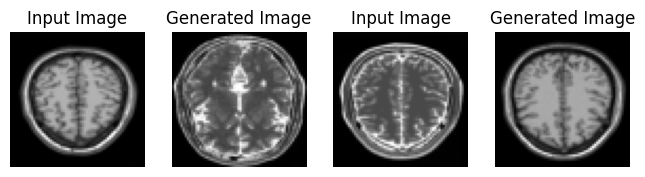

Saving checkpoint for epoch 183 at ./Trained_Model/ckpt-453


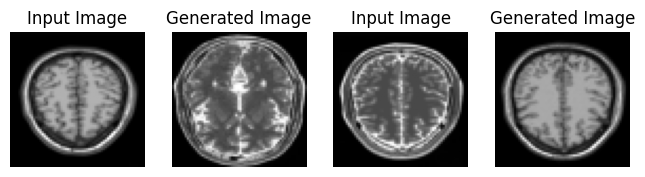

Saving checkpoint for epoch 184 at ./Trained_Model/ckpt-454


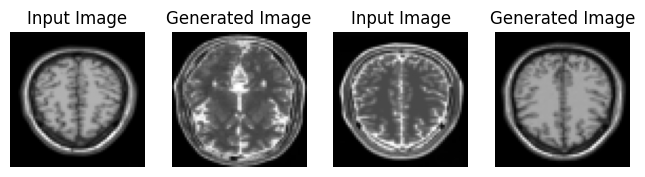

Saving checkpoint for epoch 185 at ./Trained_Model/ckpt-455


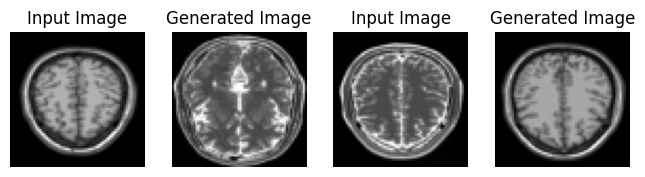

Saving checkpoint for epoch 186 at ./Trained_Model/ckpt-456


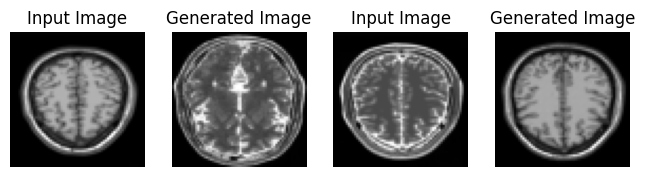

Saving checkpoint for epoch 187 at ./Trained_Model/ckpt-457


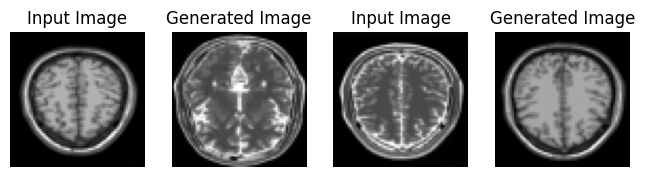

Saving checkpoint for epoch 188 at ./Trained_Model/ckpt-458


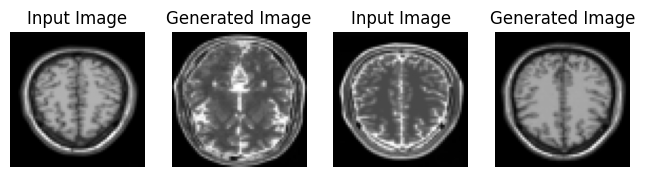

Saving checkpoint for epoch 189 at ./Trained_Model/ckpt-459


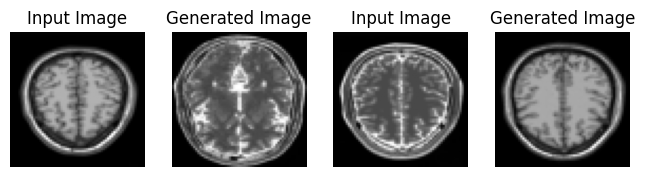

Saving checkpoint for epoch 190 at ./Trained_Model/ckpt-460


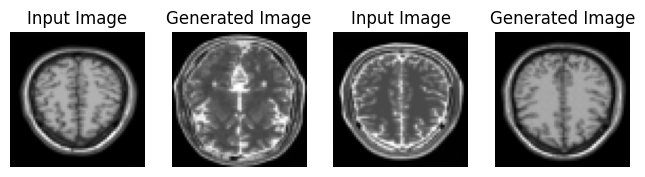

Saving checkpoint for epoch 191 at ./Trained_Model/ckpt-461


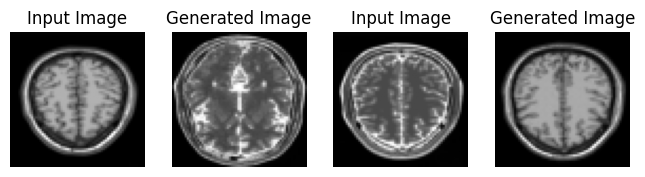

Saving checkpoint for epoch 192 at ./Trained_Model/ckpt-462


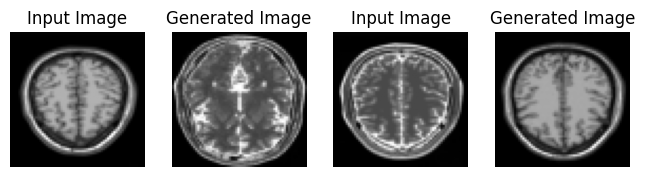

Saving checkpoint for epoch 193 at ./Trained_Model/ckpt-463


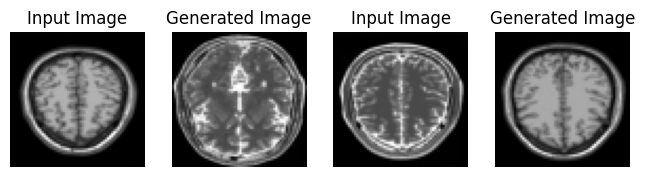

Saving checkpoint for epoch 194 at ./Trained_Model/ckpt-464


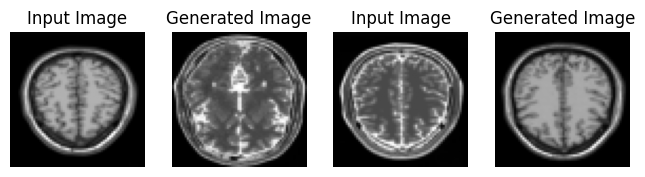

Saving checkpoint for epoch 195 at ./Trained_Model/ckpt-465


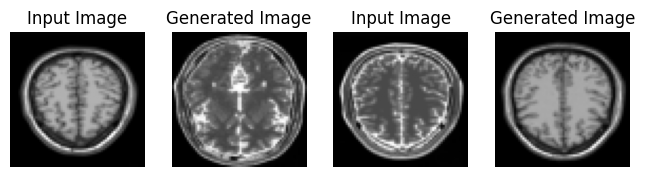

Saving checkpoint for epoch 196 at ./Trained_Model/ckpt-466


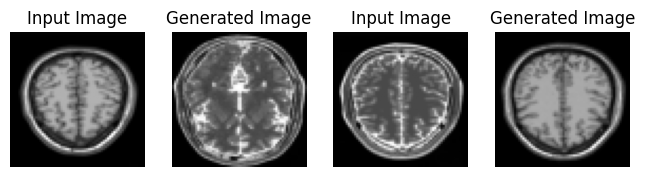

Saving checkpoint for epoch 197 at ./Trained_Model/ckpt-467


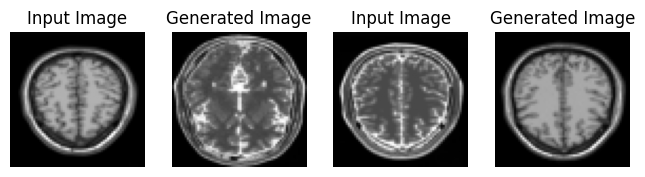

Saving checkpoint for epoch 198 at ./Trained_Model/ckpt-468


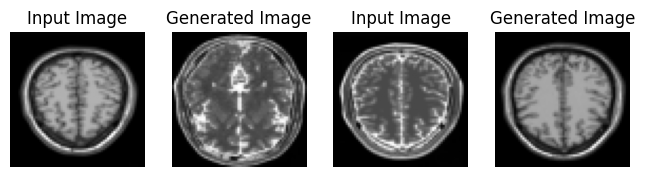

Saving checkpoint for epoch 199 at ./Trained_Model/ckpt-469


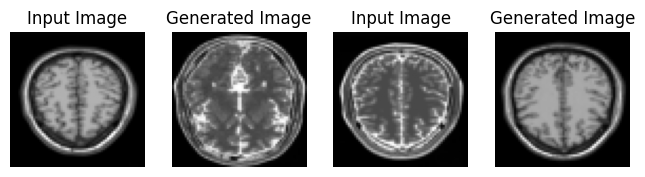

Saving checkpoint for epoch 200 at ./Trained_Model/ckpt-470


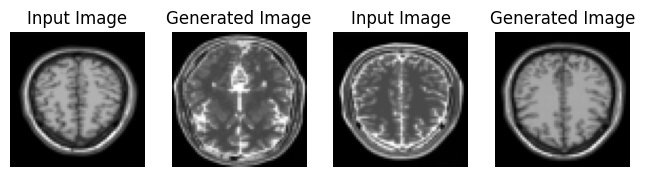

Saving checkpoint for epoch 201 at ./Trained_Model/ckpt-471


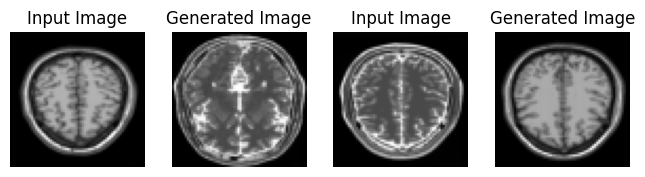

Saving checkpoint for epoch 202 at ./Trained_Model/ckpt-472


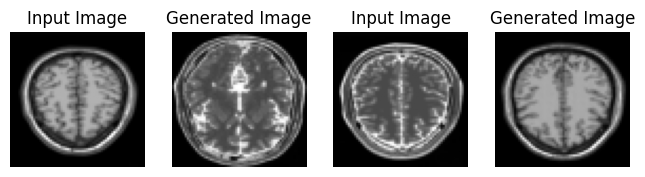

Saving checkpoint for epoch 203 at ./Trained_Model/ckpt-473


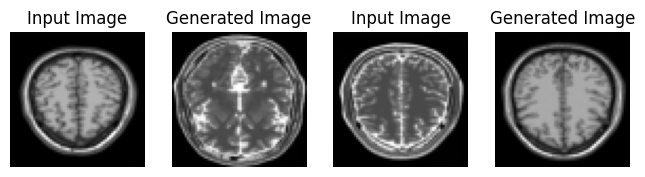

Saving checkpoint for epoch 204 at ./Trained_Model/ckpt-474


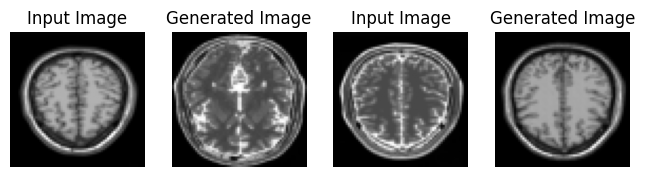

Saving checkpoint for epoch 205 at ./Trained_Model/ckpt-475


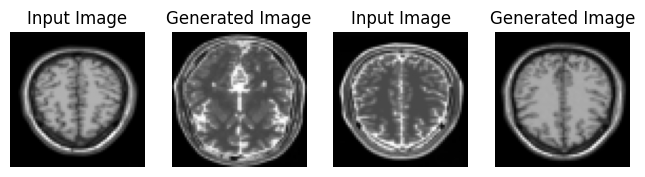

Saving checkpoint for epoch 206 at ./Trained_Model/ckpt-476


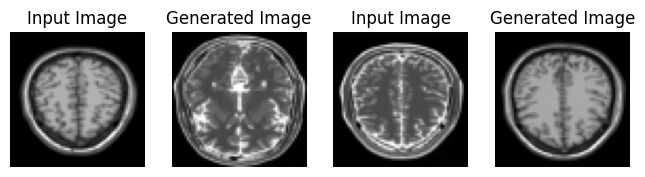

Saving checkpoint for epoch 207 at ./Trained_Model/ckpt-477


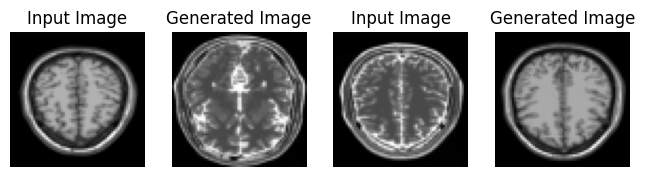

Saving checkpoint for epoch 208 at ./Trained_Model/ckpt-478


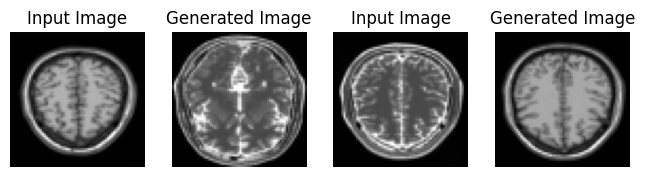

Saving checkpoint for epoch 209 at ./Trained_Model/ckpt-479


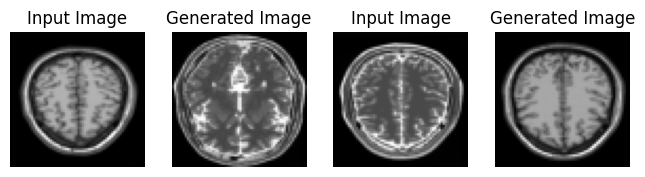

Saving checkpoint for epoch 210 at ./Trained_Model/ckpt-480


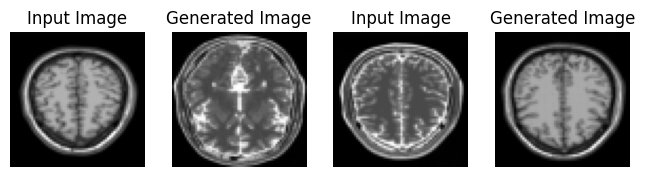

Saving checkpoint for epoch 211 at ./Trained_Model/ckpt-481


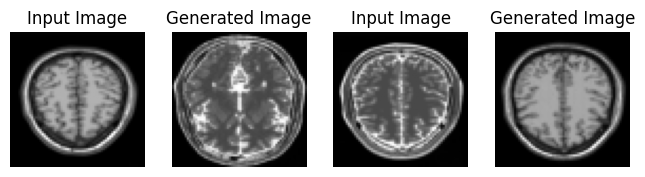

Saving checkpoint for epoch 212 at ./Trained_Model/ckpt-482


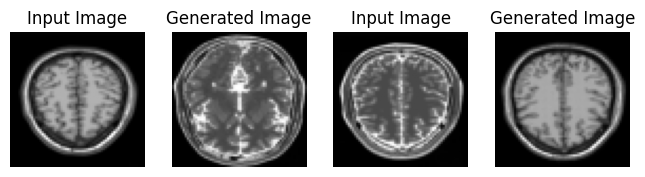

Saving checkpoint for epoch 213 at ./Trained_Model/ckpt-483


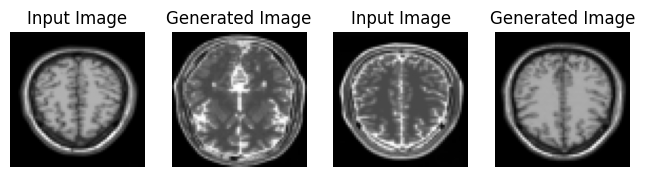

Saving checkpoint for epoch 214 at ./Trained_Model/ckpt-484


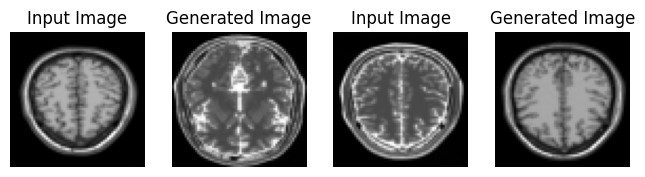

Saving checkpoint for epoch 215 at ./Trained_Model/ckpt-485


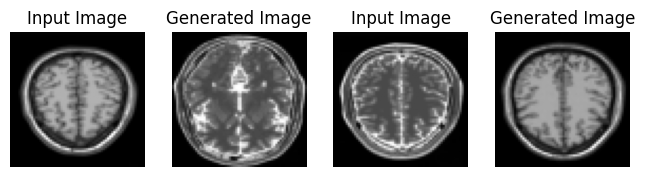

Saving checkpoint for epoch 216 at ./Trained_Model/ckpt-486


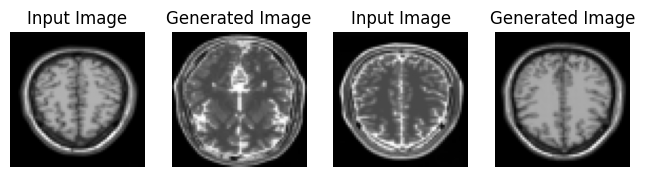

Saving checkpoint for epoch 217 at ./Trained_Model/ckpt-487


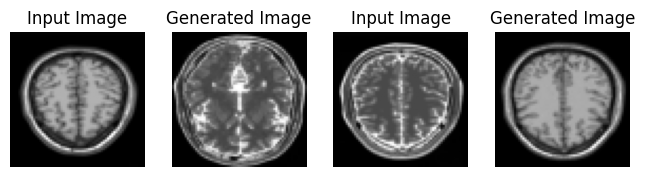

Saving checkpoint for epoch 218 at ./Trained_Model/ckpt-488


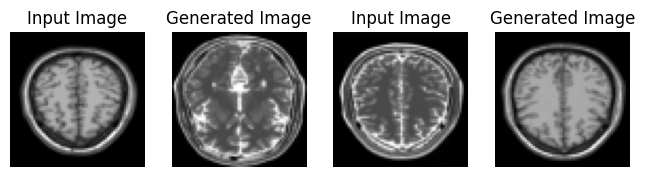

Saving checkpoint for epoch 219 at ./Trained_Model/ckpt-489


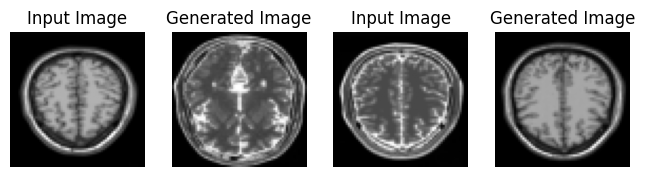

Saving checkpoint for epoch 220 at ./Trained_Model/ckpt-490


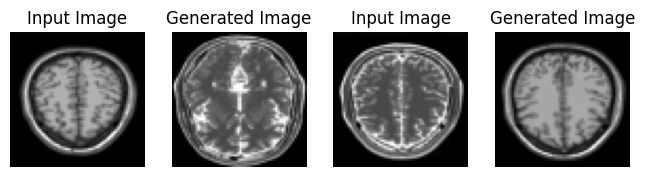

Saving checkpoint for epoch 221 at ./Trained_Model/ckpt-491


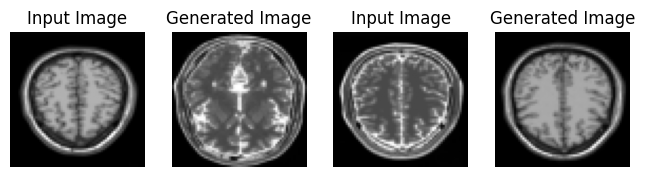

Saving checkpoint for epoch 222 at ./Trained_Model/ckpt-492


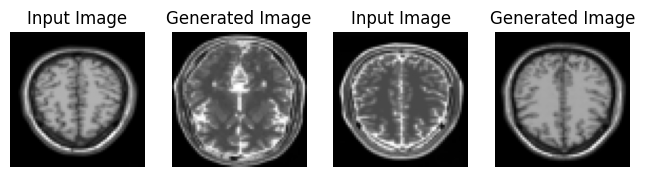

Saving checkpoint for epoch 223 at ./Trained_Model/ckpt-493


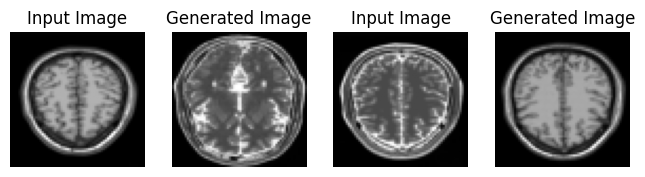

Saving checkpoint for epoch 224 at ./Trained_Model/ckpt-494


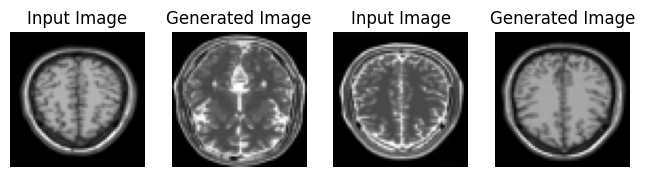

Saving checkpoint for epoch 225 at ./Trained_Model/ckpt-495


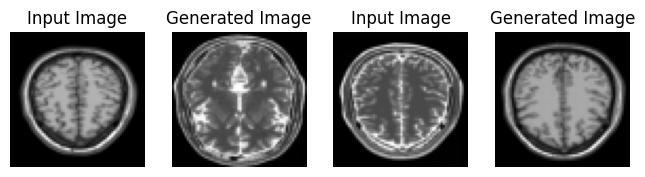

Saving checkpoint for epoch 226 at ./Trained_Model/ckpt-496


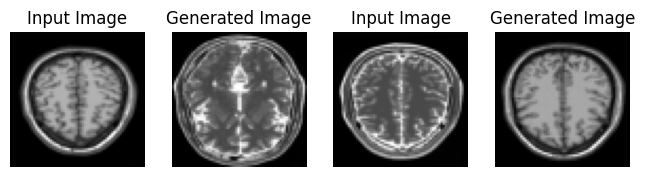

Saving checkpoint for epoch 227 at ./Trained_Model/ckpt-497


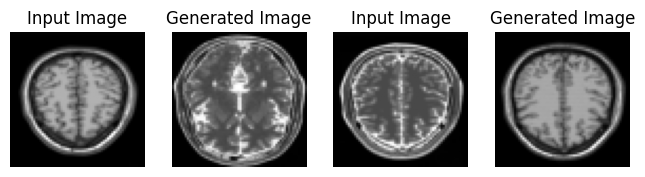

Saving checkpoint for epoch 228 at ./Trained_Model/ckpt-498


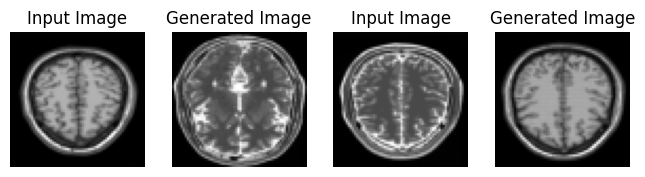

Saving checkpoint for epoch 229 at ./Trained_Model/ckpt-499


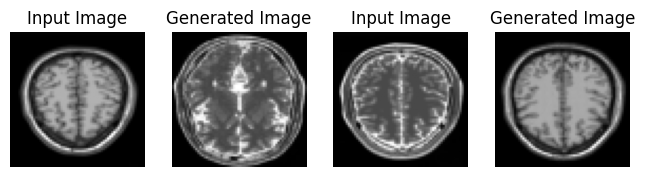

Saving checkpoint for epoch 230 at ./Trained_Model/ckpt-500


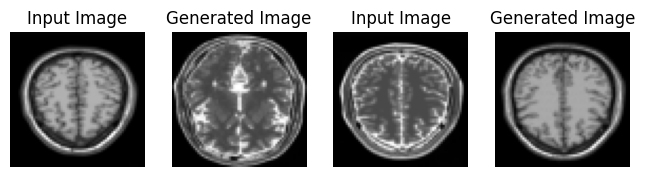

Saving checkpoint for epoch 231 at ./Trained_Model/ckpt-501


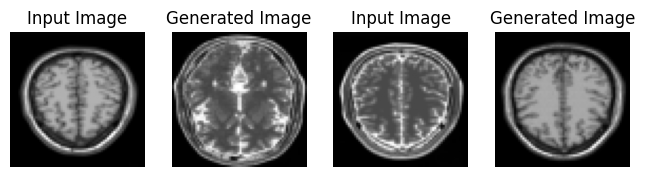

Saving checkpoint for epoch 232 at ./Trained_Model/ckpt-502


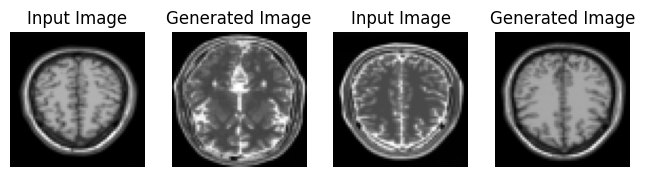

Saving checkpoint for epoch 233 at ./Trained_Model/ckpt-503


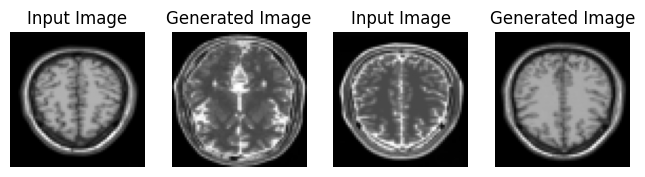

Saving checkpoint for epoch 234 at ./Trained_Model/ckpt-504


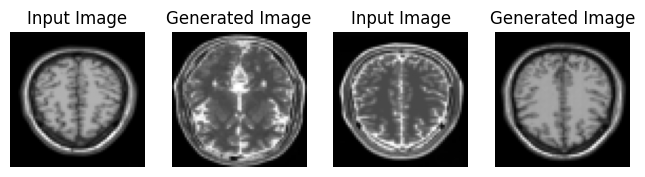

Saving checkpoint for epoch 235 at ./Trained_Model/ckpt-505


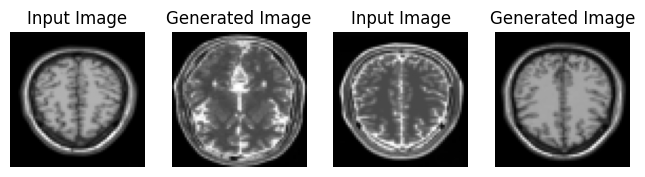

Saving checkpoint for epoch 236 at ./Trained_Model/ckpt-506


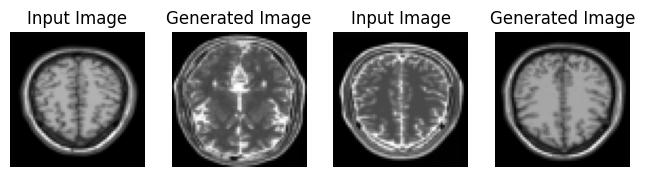

Saving checkpoint for epoch 237 at ./Trained_Model/ckpt-507


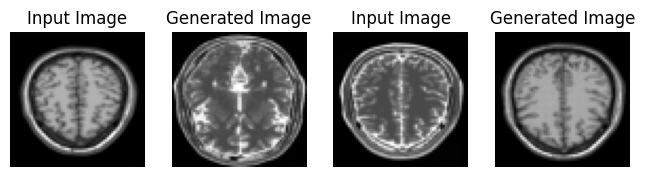

Saving checkpoint for epoch 238 at ./Trained_Model/ckpt-508


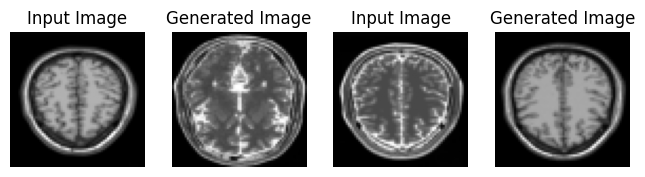

Saving checkpoint for epoch 239 at ./Trained_Model/ckpt-509


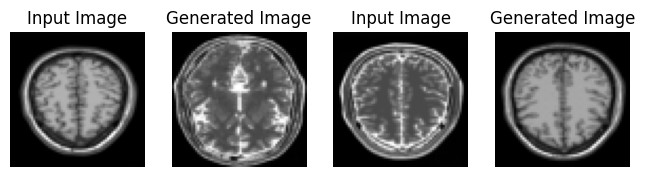

Saving checkpoint for epoch 240 at ./Trained_Model/ckpt-510


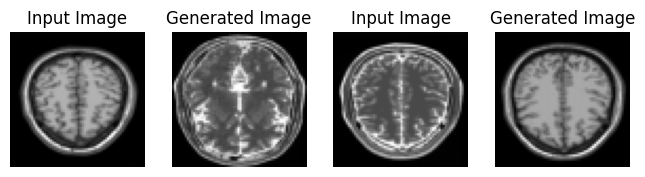

Saving checkpoint for epoch 241 at ./Trained_Model/ckpt-511


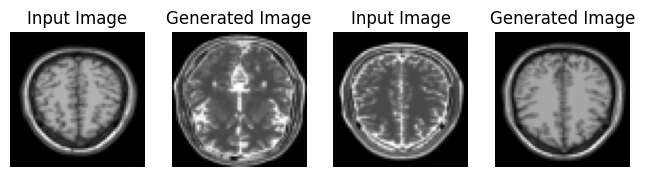

Saving checkpoint for epoch 242 at ./Trained_Model/ckpt-512


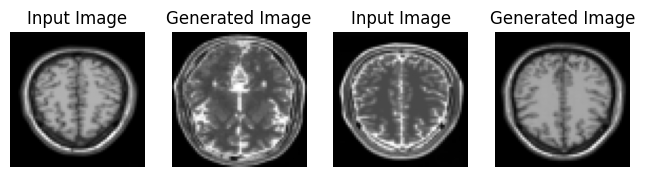

Saving checkpoint for epoch 243 at ./Trained_Model/ckpt-513


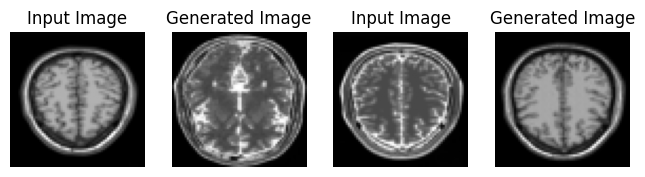

Saving checkpoint for epoch 244 at ./Trained_Model/ckpt-514


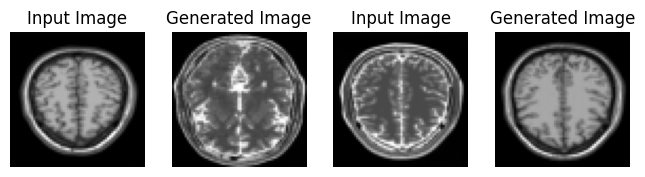

Saving checkpoint for epoch 245 at ./Trained_Model/ckpt-515


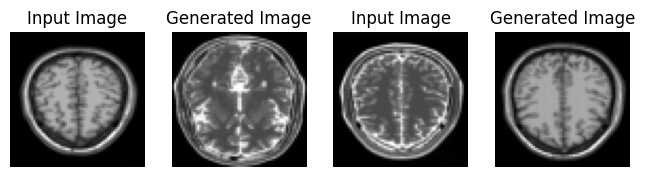

Saving checkpoint for epoch 246 at ./Trained_Model/ckpt-516


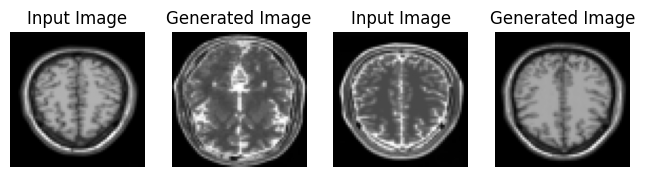

Saving checkpoint for epoch 247 at ./Trained_Model/ckpt-517


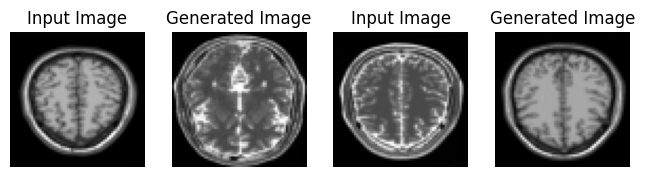

Saving checkpoint for epoch 248 at ./Trained_Model/ckpt-518


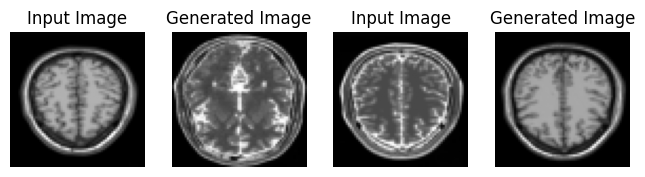

Saving checkpoint for epoch 249 at ./Trained_Model/ckpt-519


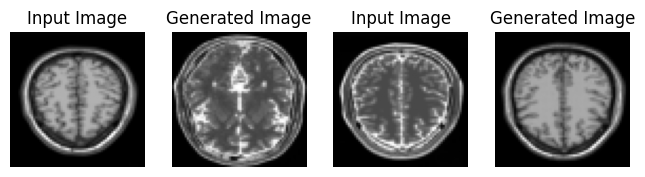

Saving checkpoint for epoch 250 at ./Trained_Model/ckpt-520
CPU times: user 7min 53s, sys: 3min 37s, total: 11min 31s
Wall time: 19min 21s


In [83]:
%%time
EPOCHS = 250

for epoch in range(1, EPOCHS+1):
    for image_x, image_y in tf.data.Dataset.zip((t1_resized, t2_resized)):
        train_step(image_x, image_y)
    generate_images(generator_g, t1_sample, generator_f, t2_sample)
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)

### 6. Generating GIF to VIsualize Results

In [84]:
anim_file = 'cyclegan_mri.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)



/tmp/ipython-input-3812419452.py:7: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-3812419452.py:9: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


In [76]:
!pip install git+https://github.com/tensorflow/docs

  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-dnhygo70
  Running command git clone --filter=blob:none --quiet https://github.com/tensorflow/docs /tmp/pip-req-build-dnhygo70
  Resolved https://github.com/tensorflow/docs to commit e21d085d5ed82504ffcec11aa82ebc78f1f2302e
  Preparing metadata (setup.py) ... done
  Created wheel for tensorflow-docs: filename=tensorflow_docs-2025.3.6.10029-py3-none-any.whl size=186351 sha256=7c56c541c2a73d599e2568a7060d73d55630e3eaebdb315d61be3b6db4524892
  Stored in directory: /tmp/pip-ephem-wheel-cache-oihzrasd/wheels/3e/88/34/48d2789bc9d37b33ddce06bccc454fae0285e5396d0a5be9d9
Successfully built tensorflow-docs



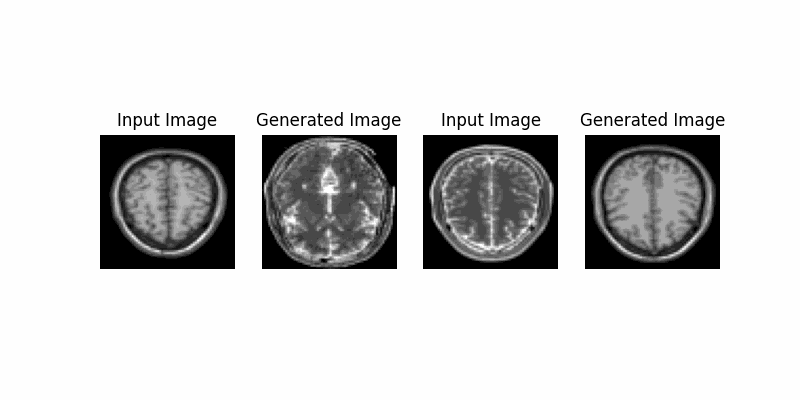

In [85]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)